<center> <font size="6"> <b> Customized Resilience Inference Measurement Model </b> </font> </center>
<br>

<center><font size="3"> <b>Authors</b> : Debayan Mandal <sup>1</sup>, Dr. Lei Zou <sup>1,*</sup>, Rohan Singh Wilkho<sup>3</sup>, Joynal Abedin<sup>1</sup>, Bing Zhou<sup>1</sup>, Dr. Heng Cai<sup>2</sup> </font></center>
<br>

<font size="3"> <sup> 1 </sup> Geospatial Exploration and Resolution (GEAR) Lab, Department of Geography, College of Geosciences, Texas A &amp; M University </font> <br>
<font size="3"> <sup> 2 </sup> Department of Geography, College of Geosciences, Texas A &amp; M University </font> <br>
<font size="3"> <sup> 3 </sup> Zachry Department of Civil and Environmental Engineering, College of Engineering, Texas A &amp; M University </font> <br>
<font size="3"> <sup> * </sup> Corresponding author: lzou@tamu.edu <br>

[Geospatial Exploration and Resolution (GEAR) Lab](https://www.geoearlab.com) <br /><br />
You can checkout the paper here: 

---

# Introduction

Resilience assessment and improvement have become increasingly important in today's world, where natural and man-made disasters are becoming more frequent and severe. Cities, communities, and organizations are recognizing the need to prepare for and mitigate the impacts of disasters and disruptions, and there is a growing body of research and practice on resilience assessment and improvement.

One significant research gap in this area is the lack of a customizable platform for resilience assessment and improvement. While there are many tools and frameworks available for assessing and improving resilience, they are often limited in their scope and applicability. Many of these tools are designed for specific types of hazards or sectors and may not be easily adapted to other contexts. Furthermore, many of these tools are proprietary and require significant resources to implement and maintain.


A customizable platform for resilience assessment and improvement would address these limitations by providing a flexible and adaptable framework that can be tailored to the needs and priorities of different users. Such a platform would allow users to customize the tools and metrics used for resilience assessment, as well as the interventions and strategies for resilience improvement. This would enable users to address specific challenges and opportunities in their context, and to leverage existing resources and knowledge to support resilience. By enabling users to tailor resilience assessment and improvement to their specific needs and priorities, such a platform would help to build more resilient communities, organizations, and systems, and contribute to a more sustainable and resilient future for all.

## Resilience Inference Measurement Model

The Resilience Inference Measurement (RIM) model was developed by Dr. Nina Lam to measure disaster resilience of various units of the community, viz. individuals and organizations [9]. It is based on the idea that resilience is dependent on adaptability as well as vulnerability, i.e., not just the ability to bounce back from adversity, but also the ability to adapt and thrive in the face of ongoing challenges and stressors. The RIM model is unique in that it evaluates resilience using empirical disaster measures such as threat, damage and recovery in line with the Sendai Framework, as well as taking on a holistic approach to measuring resilience, incorporating not only empirical factors but also the broader social and environmental context. This makes it a powerful tool for identifying areas of strength and weakness in resilience and for developing targeted interventions and strategies to build resilience in communities.

<div style="text-align:center;">
    <img src="images/RIM_basic_framework.png" alt="Image" width=800 height=500 />
</div>

The above figure suggests the preliminary idea that in one resilience cycle vulnerability is dependent on exposure and damage, while adaptability is dependent upon the damage and recovery from the natural hazard. This goes into a feedback loop and updates itself in the next resilience cycle where mitigation procedures from recovery activities reduce exposure to the particular disaster while adaptation measures reduce future disaster damages. 

# Prerequisites to Model Implementation

## Library Imports

In [6]:
import pandas as pd
import numpy as np
import geopandas as gpd
import matplotlib.pyplot as plt
from tqdm import tqdm
#import multiprocessing as mp
import folium, itertools, os, time, warnings
from IPython.display import display, clear_output
from functools import reduce
from scipy import stats
import json
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import accuracy_score
from sklearn.model_selection import train_test_split
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn import svm
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split, GridSearchCV
import ipywidgets as widgets
from IPython.display import display
from sklearn.inspection import permutation_importance
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso
from sklearn.svm import SVR
from sklearn.ensemble import RandomForestRegressor
!pip install xgboost
from xgboost import XGBRegressor
import warnings

Defaulting to user installation because normal site-packages is not writeable


In [3]:
warnings.filterwarnings("ignore")

## All the Inputs

<b>This section is only for entering filtering parameters from the whole dataset</b>

In [1]:
import preprocess as prep
widget_dict = prep.create_gui1()

In [4]:
ini = widgets.IntText(description='Initial year:')
fin = widgets.IntText(description='Final year:')
avalanche = widgets.RadioButtons(options=['Yes', 'No'], description='Avalanches:')
coastal = widgets.RadioButtons(options=['Yes', 'No'], description='Coastal disasters:')
drought = widgets.RadioButtons(options=['Yes', 'No'], description='Droughts:')
earthquake = widgets.RadioButtons(options=['Yes', 'No'], description='Earthquake:')
flooding = widgets.RadioButtons(options=['Yes', 'No'], description='Flooding:')
fog = widgets.RadioButtons(options=['Yes', 'No'], description='Fog:')
hail = widgets.RadioButtons(options=['Yes', 'No'], description='Hail:')
heat = widgets.RadioButtons(options=['Yes', 'No'], description='Heat:')
hurricane = widgets.RadioButtons(options=['Yes', 'No'], description='Hurricane:')
landslide = widgets.RadioButtons(options=['Yes', 'No'], description='Landslide:')
lightning = widgets.RadioButtons(options=['Yes', 'No'], description='Lightning:')
severestorm = widgets.RadioButtons(options=['Yes', 'No'], description='Severe storms:')
tornado = widgets.RadioButtons(options=['Yes', 'No'], description='Tornados:')
tsunami = widgets.RadioButtons(options=['Yes', 'No'], description='Tsunamis:')
wildfire = widgets.RadioButtons(options=['Yes', 'No'], description='Wildfire:')
wind = widgets.RadioButtons(options=['Yes', 'No'], description='Wind:')
winterweather = widgets.RadioButtons(options=['Yes', 'No'], description='Winter weather:')
countygrp = widgets.RadioButtons(options=['All', 'Mostly Urban','Mostly Rural', 'Completely Rural','Custom'], description='County Group:')
submit = widgets.Button(description='Submit', button_style='success')

style = {'description_width': '50%'}
ini.style = style
fin.style = style
avalanche.style = style
coastal.style = style
drought.style = style
earthquake.style = style
flooding.style = style
fog.style = style
hail.style = style
heat.style = style
hurricane.style = style
landslide.style = style
lightning.style = style
severestorm.style = style
tornado.style = style
tsunami.style = style
wildfire.style = style
wind.style = style
winterweather.style = style
countygrp.style = style

input_col1 = widgets.VBox([ini])
input_col2 = widgets.VBox([fin])
input_col3 = widgets.VBox([avalanche, drought, flooding, hail, hurricane, severestorm])
input_col4 = widgets.VBox([coastal, earthquake, fog, heat, landslide, lightning, submit])
input_col5 = widgets.VBox([ tsunami, winterweather, tornado, wildfire, wind, countygrp])

input_row = widgets.HBox([input_col1, input_col2])
display(input_row)
input_row = widgets.HBox([input_col3, input_col4, input_col5])
display(input_row)

In [2]:
print('The inputted parameters are:')
print('Duration to be computed:' + str(widget_dict['ini'].value) + ' to ' + str(widget_dict['fin'].value) +' \n')

hazards_list =["Avalanche","Tornado","Coastal","Flooding","SevereStorm","Wind","Drought","Heat","Earthquake","Fog","WinterWeather","Hail","Landslide","Lightning","Tsunami","Wildfire","Hurricane"]
print('The hazards considered in this computation are:')

for i, hazard in enumerate(hazards_list):
    if (widget_dict[hazard.lower()].value=='Yes'):
        print(f"{hazard}", end='')
        if i != len(hazards_list) - 1:
            print(', ', end='')

print(f"\n\n{widget_dict['countygrp'].value} counties will be evaluated")


The inputted parameters are:
Duration to be computed:2000 to 2020 

The hazards considered in this computation are:
Avalanche, Tornado, Coastal, Flooding, SevereStorm, Wind, Drought, Heat, Earthquake, Fog, WinterWeather, Hail, Landslide, Lightning, Tsunami, Wildfire, Hurricane

All counties will be evaluated


## Data Pre-processing

<b>Preparing Population Dataset</b>

In [ ]:
fn = prep.process_data(widget_dict)

In [6]:
pl = pd.read_csv('data/population/population.csv')

In [7]:
pl['popini'] = pl[f'{ini.value}']
pl['popfin'] = pl[f'{fin.value}']

<b> Preparing Disaster Dataset </b>

In [8]:
df = pd.read_csv('data/disaster/Disasters.csv')

<b> Filtering out years that are not chosen by the User</b>

In [9]:
index_names = df[ (df['Year'] < int(ini.value)) | (df['Year'] > int(fin.value))].index
df.drop(index_names, inplace = True)

<b>Removing Whitespaces and lowering names of hazards</b>

In [10]:
df['Disaster'] = df['Disaster'].str.replace(" ", "")
df['Disaster'] = df['Disaster'].str.lower()
df['Disaster'] = df['Disaster'].str.split('/').str[0]

<b>Removing non-selected Hazard data</b>

In [11]:
for hazard in hazards_list:
    if (globals()[hazard.lower()].value=='No'):
        index_names = df[ (df['Disaster'].str.contains((hazard.lower())))].index
        df.drop(index_names, inplace = True)
        print("Records being removed:" + hazard)

<b>Converting FIPS Code to 5 digit</b>

In [12]:
pl['FIPScounty'] = pl.apply(lambda row : str(row['STCOU']).zfill(5), axis = 1)
pl_per_year = {}

for year in range(ini.value, fin.value):  
    columns_to_select = ['FIPScounty', 'Areaname', str(year), str(year + 1)]  
    pl_year = pl[columns_to_select]
    pl_per_year[year] = pl_year

<b>Correcting formatting in Disaster database</b>

In [13]:
df['UniqueCode'] = df.apply(lambda row : row['UniqueCode'].strip('\''), axis = 1)

<b>Choosing Rural or Urban Counties</b>

In [14]:
if (countygrp.value != 'All'):
    df_orig=df
    ru = pd.read_csv('data/ruralUrban/RUdiv.csv')
    ru['FIPScounty'] = ru.apply(lambda row: str(row['FIPScounty']).zfill(5), axis=1)
    
    if countygrp.value == 'Mostly Rural':
        mr = ru[ru['Class'] == 'MR']
        df = df[df['UniqueCode'].isin(mr['FIPScounty'])]
    elif countygrp.value == 'Mostly Urban':
        mu = ru[ru['Class'] == 'MU']
        df = df[df['UniqueCode'].isin(mu['FIPScounty'])]
    elif countygrp.value == 'Completely Rural':
        cr = ru[ru['Class'] == 'CR']
        df = df[df['UniqueCode'].isin(cr['FIPScounty'])]
        
    rows_removed = len(df_orig) - len(df)
    print(f"{rows_removed} rows removed from original dataframe from {len(df_orig)}")

<b>Choosing Custom Counties or States</b>

In [15]:
choices_states = []
choices_counties = []
if countygrp.value == 'Custom':
    text_input_states = widgets.Text(description='Specific States:')
    text_input_counties = widgets.Text(description='Specific Counties:')
    display(text_input_states, text_input_counties)
    
    def handle_states_change(change):
        choices_states.extend(change['new'].split(','))

    def handle_counties_change(change):
        choices_counties.extend(change['new'].split(','))

    text_input_states.observe(handle_states_change, names='value')
    text_input_counties.observe(handle_counties_change, names='value')

In [16]:
if choices_states or choices_counties:
    df_orig = df
    cod = pd.read_csv('data/ruralUrban/RUdiv.csv')

    cus = cod.copy()
    if choices_states:
        cus = cus[cus['State Abbrv'].isin(choices_states)]
    elif choices_counties:
        cus = cus[cus['FIPScounty'].isin(choices_counties)]
    cus['UniqueCode'] = cus['FIPScounty'].astype(str).str.zfill(5)
    df = df[df['UniqueCode'].isin(cus['UniqueCode'])]
    rows_removed = len(df_orig) - len(df)
    print(f"{rows_removed} rows removed from the original dataframe (from {len(df_orig)} rows)")

<b>Storing it in a new database</b>

In [17]:
fn = pd.merge(df,pl,left_on='UniqueCode',right_on='FIPScounty',how='inner')

# Three Empirical Factor Calculation

<div style="text-align:center;">
    <img src="images/3FactorCalc.png" alt="Image" width=800 height=500 />
</div>

Above figure gives us an overview of how the RIM model quantifies resilience. Weightage for different hazards is calculated to understand the impact of each on the community based on the damage wrought per unit population. These weightages are used to divide exposure quotient for every type of disaster considered. The first empirical factor calculated here is Exposure. This is based on the frequency of the natural hazards affecting a particular community unit. Secondly, the damage factor is calculated as the total damage per capita on the county considered for the study. Lastly, the recovery variable gives a quantification of the community trying to return back to its original state before disaster.  As population change is one prominent factor for quantifying the community works despite disaster, i.e., if there has been migration to and from the community - this has been evaluated here as a Recovery factor. The increase in population has been calculated to be the recovery factor.

<b>Calculation of <u>Damage per day per capita population</u></b>

In [18]:
fn['Perdaycapdmg'] = fn['DamageRIM']/fn['Duration(Day)']

## Weight Calculation

### Total Damage per day per capita population

<b>Calculation of <u>Total Damage per day per capita population</u> per Hazard type</b>

In [19]:
sm = {}
sm = fn.groupby('Disaster')['Perdaycapdmg'].sum()

### Average Damage per day per capita population

<b>Calculation of <u>Average Damage per day per capita population</u> per Hazard type</b>

In [20]:
mn = {}
mn = fn.groupby('Disaster')['Perdaycapdmg'].mean()

### Count

<b>Calculation of <u>Frequency</u> of each Hazard type</b>

In [21]:
ct = {}
ct = fn.groupby('Disaster')['Perdaycapdmg'].count()

### Weight per Hazard Type

<b><p style="color:orange">Weightage for each hazard type = Damage per day per capita / Frequency</p></b>

In [22]:
weight = {}
weight = pd.merge(ct, sm, on=["Disaster"], how="inner")
weight = pd.merge(weight, mn, on=["Disaster"], how="inner")
weight.rename(columns={'Perdaycapdmg_x': 'Count', 'Perdaycapdmg_y': 'Sum', 'Perdaycapdmg': 'Mean'}, inplace=True)

In [23]:
weight['Probability'] =weight['Count']/((fin.value -ini.value)*365)

In [24]:
weight.to_csv('calculation/Weight.csv')

## Exposure Calculation

<b><p style="color:orange">Exposure for each hazard type = Duration(days) * Weightage_Mean* Probability</p></b>

### Exposure by Hazard Event

In [25]:
for year in range(ini.value, fin.value + 1):
    fn_year = fn[fn['Year'] == year]
    fn_year['Mean'] = fn_year['Disaster'].map(weight['Mean'])
    fn_year['Probability'] = fn_year['Disaster'].map(weight['Probability'])
    fn_year['Exposure'] = fn_year['Duration(Day)'] * fn_year['Mean'] * fn_year['Probability']
    fn.loc[fn['Year'] == year, 'Exposure'] = fn_year['Exposure']

### Exposure by County

In [26]:
ex_per_year = {}

for year in range(ini.value, fin.value + 1):
    fn_year = fn[fn['Year'] == year]
    ex = fn_year.groupby('FIPScounty')['Exposure'].sum().to_frame()
    ex_per_year[year] = ex

## Damage Calculation

<b><p style="color:orange">Damage per capita = (Crop + Property Damage)/ Initial Population</p></b>

In [27]:
dg_per_year = {}

for year in range(ini.value, fin.value + 1):
    fn_year = fn[fn['Year'] == year]
    dg = fn_year.groupby('FIPScounty')['DamageRIM'].sum().to_frame()
    dg_per_year[year] = dg

In [28]:
edr_per_year = {}

for year in range(ini.value, fin.value):
    pl_year = pl_per_year[year]
    edr = pd.merge(pl_year, dg_per_year[year], on=["FIPScounty"], how="inner")
    edr = pd.merge(edr, ex_per_year[year], on=["FIPScounty"], how="inner")
    
    edr_per_year[year] = edr

## Recovery Calculation

<b><p style="color:orange">Recovery per county = (Final - Initial Population)/ Initial Population</p></b>

In [29]:
for year in range(ini.value, fin.value):
    edr_per_year[year]['Recovery'] = edr_per_year[year][str(year)].where(edr_per_year[year][str(year)] == 0, (edr_per_year[year][str(year+1)]-edr_per_year[year][str(year)])/edr_per_year[year][str(year)])

## Normalizing Parameters

Normalization is the process of transforming data into a common scale so that the features with larger numeric ranges do not dominate over the ones with smaller numeric ranges. Z-score normalization is a common method of normalization that scales the data to have a mean of 0 and a standard deviation of 1. The z-score for a data point is calculated by subtracting the mean of the data from the data point and then dividing by the standard deviation of the data. This results in a new distribution of the data with a mean of 0 and a standard deviation of 1.

<b>Drop missing values</b>

In [30]:
for year in range(ini.value, fin.value):
    edr_per_year[year].dropna(subset=['Recovery'], inplace=True)
    edr_per_year[year].dropna(subset=['DamageRIM'], inplace=True)
    edr_per_year[year].dropna(subset=['Exposure'], inplace=True)

<b>Appending all dataframes</b>

In [31]:
df_list = list()
year, counter = ini.value, 0

for df in edr_per_year.values():
    df = df[['FIPScounty','Areaname','DamageRIM','Exposure','Recovery']] 
    df['Year'] = year + counter
    df_list.append(df[['FIPScounty','Areaname','DamageRIM','Exposure','Recovery', 'Year']])
    counter += 1

edr_tot = pd.concat(df_list)

<b>Min Max Scaling (Prev Calculating using z-score)</b>

In [1]:
## Min Max Scaling
edr_tot['Normalized_Damage'] = (edr_tot['DamageRIM'] - edr_tot['DamageRIM'].min())/(edr_tot['DamageRIM'].max() - edr_tot['DamageRIM'].min())
#edr_tot['Normalized_Exposure'] = (edr_tot['Exposure'] - edr_tot['Exposure'].min())/(edr_tot['Exposure'].max() - edr_tot['Exposure'].min())
edr_tot['Normalized_Recovery'] = (edr_tot['Recovery'] - edr_tot['Recovery'].min())/(edr_tot['Recovery'].max() - edr_tot['Recovery'].min())
#Vulnerability
edr_tot['Vul'] = edr_tot['DamageRIM'] - edr_tot['Exposure']
edr_tot['NVul'] = (edr_tot['Vul'] - edr_tot['Vul'].min())/(edr_tot['Vul'].max() - edr_tot['Vul'].min())

NameError: name 'edr_tot' is not defined

# Disaster Resilience Indexes

<div style="text-align:center;">
    <img src="images/AdapVuln.png" alt="Image" width=800 height=500 />
</div>

Finally, the two resilience indexes are calculated. Vulnerability index is considered as the susceptibility of a community to the vagaries of natural hazards. It is calculated as the difference between normalized damage and exposure. The theory holds that a community that suffers similar destruction in less frequent disasters will be considered more vulnerable than a community that experiences more frequent disasters. Adaptability index, on the other hand, is considered as the ability of the community to bounce back from the disaster to normal activity levels. It is calculated as the difference between normalized recovery and damage. This theory is self-explanatory since it quantifies how much a community has recovered from the damage it had suffered.

## Adaptability Calculation

Adaptability in disaster resilience refers to the ability of a community or system to adjust and respond effectively to changes or disruptions caused by a disaster. This includes the capacity to anticipate, absorb, and recover from the impacts of a disaster, and to learn from the experience in order to better prepare for future events.

<b>LookUp Kit for Adaptability: - </b>

<ol>
    <li>Adaptability Low</li>
    <li>Adaptability Medium</li>
    <li>Adaptability High</li>
    <li>Adaptability Extremely High</li>
</ol>

<b><p style="color:maroon">Adaptability = Normalized Recovery - Normalized Damage</p></b>

In [33]:
edr_tot['Adaptability'] = edr_tot['Normalized_Recovery'] - edr_tot['Normalized_Damage']

a1 = edr_tot['Adaptability'].quantile(0.25)
a2 = edr_tot['Adaptability'].quantile(0.50)
a3 = edr_tot['Adaptability'].quantile(0.75)

conditions = [
    (edr_tot['Adaptability'] <= a1),
    (edr_tot['Adaptability'] > a1) & (edr_tot['Adaptability'] <= a2),
    (edr_tot['Adaptability'] > a2) & (edr_tot['Adaptability'] <= a3),
    (edr_tot['Adaptability'] > a3)
]

values = ['Low', 'Medium', 'High', 'Extremely High']
valuesnum = [1, 2, 3, 4]

edr_tot['adaptier'] = np.select(conditions, values)
edr_tot['adaptiernum'] = np.select(conditions, valuesnum)

## Vulnerability Calculation

Vulnerability in disaster resilience refers to the susceptibility of a community or system to potential harm or damage caused by natural or human-made hazards. This can be influenced by various factors such as socioeconomic status, physical and environmental conditions, and access to resources and services. Reducing vulnerability is a crucial aspect of building resilience to disasters, as it enables communities to better withstand and recover from the impacts of disasters.

<b>LookUp Kit for Vulnerability: - </b>

<ol>
    <li>Vulnerability Low</li>
    <li>Vulnerability Medium</li>
    <li>Vulnerability High</li>
    <li>Vulnerability Extremely High</li>
</ol>

<b><p style="color:maroon">Vulnerability = Normalized Damage - Normalized Exposure</p></b>

In [34]:
edr_tot['Vulnerability'] = edr_tot['NVul']
   
    
v1 = edr_tot['Vulnerability'].quantile(0.25)
v2 = edr_tot['Vulnerability'].quantile(0.50)
v3 = edr_tot['Vulnerability'].quantile(0.75)

conditions = [
    (edr_tot['Vulnerability'] <= v1),
    (edr_tot['Vulnerability'] > v1) & (edr_tot['Vulnerability'] <= v2),
    (edr_tot['Vulnerability'] > v2) & (edr_tot['Vulnerability'] <= v3),
    (edr_tot['Vulnerability'] > v3)
]

values = ['Low', 'Medium', 'High', 'Extremely High']
valuesnum = [1, 2, 3, 4]

edr_tot['vultier'] = np.select(conditions, values)
edr_tot['vultiernum'] = np.select(conditions, valuesnum)

## Composite Index Calculation

<b>LookUp Kit for Index Number: - </b>

<ol>
    <li>Vulnerability extremely high, Adaptability low</li>
    <li>Vulnerability high, Adaptability low</li>
    <li>Vulnerability med,  Adaptability low</li>
    <li>Vulnerability low,  Adaptability low</li>
    <li>Vulnerability extremely high, Adaptability med</li>
    <li>Vulnerability high, Adaptability med</li>
    <li>Vulnerability med,  Adaptability med</li>
    <li>Vulnerability low,  Adaptability med</li>
    <li>Vulnerability extremely high, Adaptability high</li>
    <li>Vulnerability high, Adaptability high</li>
    <li>Vulnerability med,  Adaptability high</li>
    <li>Vulnerability low,  Adaptability high</li>
    <li>Vulnerability extremely high, Adaptability extremely high</li>
    <li>Vulnerability high, Adaptability extremely high</li>
    <li>Vulnerability med,  Adaptability extremely high</li>
    <li>Vulnerability low,  Adaptability extremely high</li>
</ol>

The authors here hold the notion that adaptability defines the resilience of a community more prominently than the vulnerability. This is so as we define a resilient community as one which can return to it's normal after being hit by a disaster. Hence, higher value of index is given to higher indexes of adaptability. However, the authors do acknowledge that at different scenarios, this definition may not hold true. The user is encouraged to switch around the values of the composite index by editing the <b>conditions2</b> variable to suit their needs.

In [35]:
edr_tot['NAdap'] = (edr_tot['Adaptability'] - edr_tot['Adaptability'].min())/(edr_tot['Adaptability'].max() - edr_tot['Adaptability'].min())

In [36]:
#edr_tot['Resilience']=edr_tot['Adaptability']-edr_tot['Vulnerability']
edr_tot['Resilience']=edr_tot['NAdap']-edr_tot['Vulnerability']

In [37]:
conditions2 = [
    (edr_tot['vultier'] == 'Extremely High') & (edr_tot['adaptier'] == 'Low'),
    (edr_tot['vultier'] == 'High') & (edr_tot['adaptier'] == 'Low'),
    (edr_tot['vultier'] == 'Medium') & (edr_tot['adaptier'] == 'Low'),
    (edr_tot['vultier'] == 'Low') & (edr_tot['adaptier'] == 'Low'),
    (edr_tot['vultier'] == 'Extremely High') & (edr_tot['adaptier'] == 'Medium'),
    (edr_tot['vultier'] == 'High') & (edr_tot['adaptier'] == 'Medium'),
    (edr_tot['vultier'] == 'Medium') & (edr_tot['adaptier'] == 'Medium'),
    (edr_tot['vultier'] == 'Low') & (edr_tot['adaptier'] == 'Medium'),
    (edr_tot['vultier'] == 'Extremely High') & (edr_tot['adaptier'] == 'High'),
    (edr_tot['vultier'] == 'High') & (edr_tot['adaptier'] == 'High'),
    (edr_tot['vultier'] == 'Medium') & (edr_tot['adaptier'] == 'High'),
    (edr_tot['vultier'] == 'Low') & (edr_tot['adaptier'] == 'High'),
    (edr_tot['vultier'] == 'Extremely High') & (edr_tot['adaptier'] == 'Extremely High'),
    (edr_tot['vultier'] == 'High') & (edr_tot['adaptier'] == 'Extremely High'),
    (edr_tot['vultier'] == 'Medium') & (edr_tot['adaptier'] == 'Extremely High'),
    (edr_tot['vultier'] == 'Low') & (edr_tot['adaptier'] == 'Extremely High')
]
values2 = [1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16]

edr_tot['index'] = np.select(conditions2, values2)

In [38]:
prgr = edr_tot

In [39]:
prgr['uniqueID'] = prgr['FIPScounty'] + "_" + prgr['Year'].astype(str)
prgr['FIPSstate'] = prgr['FIPScounty'].str[:2]

In [40]:
prgr.to_csv('calculation/Priorigrp.csv')

In [41]:
final_df = prgr.groupby('FIPScounty')[['adaptiernum', 'vultiernum', 'index']].mean().round(0).astype(int)
final_df['Areaname']=prgr.groupby('FIPScounty')['Areaname'].first()
final_df = final_df.reset_index()

In [42]:
map_df = prgr.groupby('FIPScounty')[['Vulnerability', 'Adaptability', 'Resilience']].mean().reset_index()

## Priori Group Visualization

<div style="text-align:center;">
    <img src="images/Viz.png" alt="Image" width=700 height=500 />
</div>

### Merging geometric dataset to results

In [102]:
county_geo = "data/counties/geojson-counties-fips.json"
geoJSON_df = gpd.read_file(county_geo)
geoJSON_df = geoJSON_df.rename(columns = {"id":"FIPScounty"})
map_df = geoJSON_df.merge(map_df, on="FIPScounty")
map_df = map_df.dropna(subset=['geometry'])
map_df.to_csv('calculation/Map.csv')

In [109]:
quantile_labels = ["Low", "Medium", "High", "Extremely High"]
quantiles = [0, .25, .5, .75, 1]
for col in ['Resilience', 'Vulnerability', 'Adaptability']:
    map_df[col + '_quantile_label'] = pd.qcut(map_df[col], q=quantiles, labels=quantile_labels)
quantile_mapping = {"Low": 1, "Medium": 2, "High": 3, "Extremely High": 4}
for col in ['Resilience_quantile_label', 'Vulnerability_quantile_label', 'Adaptability_quantile_label']:
    map_df[col + '_numeric'] = map_df[col].map(quantile_mapping)

### Making Interactive Map

In [110]:
import json

map_json = json.loads(map_df.to_json())

def generate_choropleth(geo_data, data, columns, key_on, fill_color, legend_name, map):
    choropleth = folium.Choropleth(
        geo_data=geo_data,
        data=data,
        columns=columns,
        key_on=key_on,
        fill_color=fill_color, fill_opacity=0.7, line_opacity=0.2,
        legend_name=legend_name,
        smooth_factor=0,
        line_color="#0000",
        name=legend_name,
        show=False,
        overlay=True,
        nan_fill_color="Grey",
    ).add_to(map)
    return choropleth

geo_data = json.load(open("data/counties/geojson-counties-fips.json"))
map = folium.Map(location=[37.0902, -95.7129], zoom_start=4.4)

generate_choropleth(geo_data, map_df, ['FIPScounty', 'Resilience_quantile_label_numeric'], 'feature.id', 'YlGnBu', 'Resilience Score', map)
generate_choropleth(geo_data, map_df, ['FIPScounty', 'Vulnerability_quantile_label_numeric'], 'feature.id', 'Reds', 'Vulnerability', map)
generate_choropleth(geo_data, map_df, ['FIPScounty', 'Adaptability_quantile_label_numeric'], 'feature.id', 'Blues', 'Adaptability', map)

style_function = lambda x: {'fillColor': '#ffffff', 'color':'#000000', 'fillOpacity': 0.1, 'weight': 0.1}
highlight_function = lambda x: {'fillColor': '#000000', 'color':'#000000', 'fillOpacity': 0.50, 'weight': 0.1}

hov = folium.features.GeoJson(
    data=map_df,
    style_function=style_function, 
    control=False,
    highlight_function=highlight_function, 
    tooltip=folium.features.GeoJsonTooltip(
        fields=['NAME', 'Resilience_quantile_label', 'Adaptability_quantile_label', 'Vulnerability_quantile_label'],
        aliases=['County:', 'Resilience Score:', 'Adaptability:', 'Vulnerability:'],
        style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;")
    )
)
map.add_child(hov)
map.keep_in_front(hov)
folium.LayerControl(collapsed=False).add_to(map)

title = f"This displays the aggregate resilience indexes from {ini.value} to {fin.value}"
display(HTML(f"<b><p style='text-align: center; font-size: 34px'>{title}</p></b>"))
display(map)

# Socio-Economic Data Processing

## Post Groups with Customisable Machine Learning

<div style="text-align:center;">
    <img src="images/ML.png" alt="Image" width=700 height=500 />
</div>

The framework uses Machine Learning (ML) models to determine the driving factors for the vulnerability and adaptability indices. Both regressors and classifiers are provided. The numerical  resilience values are continuous values, so is given the option of training and testing regression models. The resilience classes, i.e. Adaptability, Vulnerability and Resilience Index are given the option of training and testing classifier models. 

After splitting the dataset into training and testing sets, it performs hyperparameter tuning using Grid Search CV. Hyperparameter tuning allows optimization of the performance of models. It will then choose models that yield the lowest average Root Mean Squared Error (RMSE) values or Accuracy scores in the cross validation process.

<u>Re-training tuned models</u>: Once it finds the optimized hyperparameters for each model, it initializes the model with those parameters, and re-train on the original training set.

<u>Evaluating final performance</u>: Both optimization score and feature importance is printed at the end of each ML model training.

### Variable Correlation

<b>Checking data correlation:</b>

In [43]:
folder_path = 'data/variables'
data = pd.DataFrame()
for year in range(ini.value, fin.value):
    filename = os.path.join(folder_path, str(year) + '.csv')
    if not os.path.exists(filename):
        print(f"No CSV file found for the year {year}.")
    else:
        year_data = pd.read_csv(filename)
        year_data = year_data.replace(np.nan, 0)
        year_data['Year'] = year
        year_data['GEOID'] = year_data['STCOU'].astype(str).str.zfill(5)
        year_data['uniqueID'] = year_data['GEOID'] + "_" + year_data['Year'].astype(str)
        data = data.append(year_data, ignore_index=True)
X = data

In [44]:
extra_row = final_df[~final_df['FIPScounty'].isin(data['GEOID'])]

if not extra_row.empty:
    print("The following row is extra:")
    print(extra_row)
else:
    print("No extra rows found.")

No extra rows found.


In [45]:
if 'GEOID' in data.columns:
    data = data.drop('GEOID', axis=1)
if 'STCOU' in data.columns:
    data = data.drop('STCOU', axis=1)
if 'Areaname' in data.columns:
    data = data.drop('Areaname', axis=1)
if 'Year' in data.columns:
    data = data.drop('Year', axis=1)

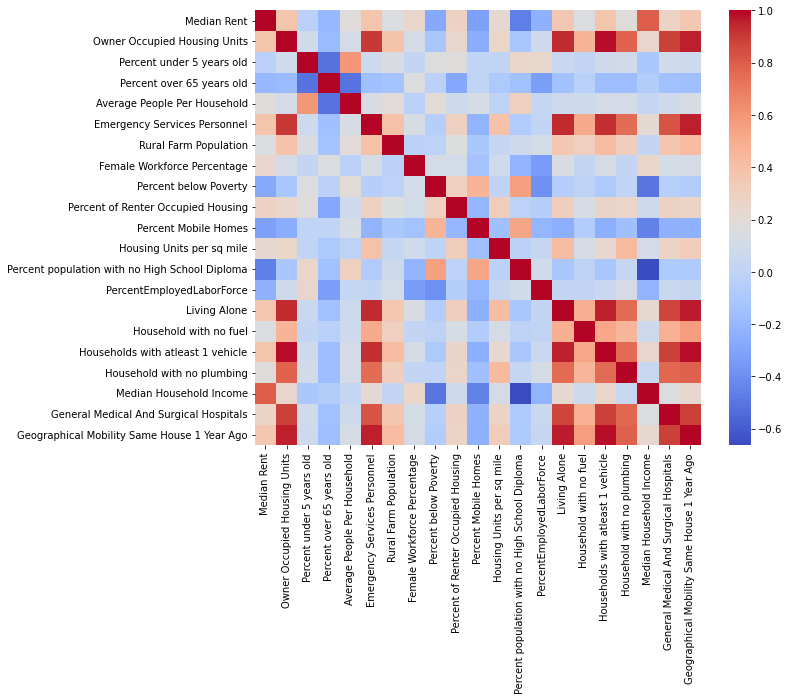

In [46]:
corr_matrix = data.corr()
fig, ax = plt.subplots(figsize=(10, 8))
sns.heatmap(corr_matrix, cmap="coolwarm", ax=ax)
plt.show()

In general, it is desirable to avoid using highly correlated independent variables as inputs to a machine learning model. This is because highly correlated variables can lead to overfitting, where the model fits the noise in the data instead of the underlying relationships between the independent and dependent variables. 

A commonly used rule of thumb is to avoid using variables with a correlation coefficient above 0.7 or below -0.7. However, the exact threshold for acceptable correlation depends on the specific problem and the nature of the data. It is generally a good idea to examine the pairwise correlation between the independent variables and remove highly correlated variables before fitting a machine learning model.

In [47]:
print("Enter method for dropping columns: ")
option_a = widgets.Checkbox(description='Remove by selecting names')
option_b = widgets.Checkbox(description='Remove by correlation index')
display(option_a)
display(option_b)

Enter method for dropping columns: 


Checkbox(value=False, description='Remove by selecting names')

Checkbox(value=False, description='Remove by correlation index')

In [48]:
if option_a.value:
        checkboxes = []
        for col in data.columns:
            checkbox = widgets.Checkbox(description=col)
            checkboxes.append(checkbox)

        checkboxes_widget = widgets.VBox(checkboxes)
        display(checkboxes_widget)

        button = widgets.Button(description="Drop Columns")
        display(button)

        def drop_columns(button):
            columns_to_drop = []
            for i in range(len(checkboxes)):
                if checkboxes[i].value:
                    columns_to_drop.append(data.columns[i])

            X.drop(columns_to_drop, axis=1, inplace=True)
            print("Columns dropped:", columns_to_drop)
            print("Updated dataframe:")
            display(X)

        button.on_click(drop_columns)

In [49]:
if option_b.value:
        to_remove = set()
        threshold = input("Enter the correlation index (0.7 is usual):")
        print("Columns being removed because of high correlation:\n")
        for i in range(len(corr_matrix.columns)):
            for j in range(i):
                if abs(corr_matrix.iloc[i, j]) >= float(threshold):
                    colname = corr_matrix.columns[i]
                    to_remove.add(colname)
                    
        for colname in to_remove:
            print(colname)
        X = X.drop(to_remove, axis=1)

Enter the correlation index (0.7 is usual): 0.7


Columns being removed because of high correlation:

General Medical And Surgical Hospitals
Household with no plumbing
Geographical Mobility Same House 1 Year Ago
Median Household Income
Living Alone
Emergency Services Personnel
Households with atleast 1 vehicle


In [50]:
if 'GEOID' in X.columns:
    X = X.drop('GEOID', axis=1)
if 'STCOU' in X.columns:
    X = X.drop('STCOU', axis=1)
if 'Areaname' in X.columns:
    X = X.drop('Areaname', axis=1)
if 'Year' in X.columns:
    X = X.drop('Year', axis=1)

In [51]:
save_df = pd.DataFrame()
save_df=X.iloc[:,:]
save_df=save_df.reset_index(drop=True)

In [52]:
save_df['Y_Class'] = save_df['uniqueID'].map(prgr.set_index('uniqueID')['index'])
save_df['YA_Class'] = save_df['uniqueID'].map(prgr.set_index('uniqueID')['adaptiernum'])
save_df['YV_Class'] = save_df['uniqueID'].map(prgr.set_index('uniqueID')['vultiernum'])
save_df['YA_Value'] = save_df['uniqueID'].map(prgr.set_index('uniqueID')['Adaptability'])
save_df['YV_Value'] = save_df['uniqueID'].map(prgr.set_index('uniqueID')['Vulnerability'])
save_df['FIPSstate'] = save_df['uniqueID'].map(prgr.set_index('uniqueID')['FIPSstate'])

In [53]:
save_df['YR_Value'] = save_df['uniqueID'].map(prgr.set_index('uniqueID')['Resilience'])

In [54]:
#Finding number of entries with no value
num_rows_with_nan = save_df.isna().any(axis=1).sum()
print(num_rows_with_nan)

14655


In [55]:
save_df = save_df.dropna()

In [56]:
#Dependent variables for classifiers
y_class = save_df['Y_Class']
ya_class = save_df['YA_Class']
yv_class = save_df['YV_Class']
#Dependent variables for regressors
yr_value = save_df['YR_Value']
ya_value = save_df['YA_Value']
yv_value = save_df['YV_Value']

In [57]:
#Independent variables
X=save_df.iloc[:,0:-8]

### Feature Scaling

<p> Why? - To have an unbiased evaluation. Otherwise Eucledian distance mire the results. If the features are on different scales, the larger ones can have a disproportionately large effect on the model, leading to biased results. By scaling the features to have zero mean and unit variance (using techniques such as StandardScaler or MinMaxScaler), we can ensure that all features have a similar impact on the model. </p>

In [58]:
from sklearn.preprocessing import MinMaxScaler

In [59]:
sc = MinMaxScaler()
X = sc.fit_transform(X)

### Test-train split

It divides the entire dataset into a user-inputted split. The training set is used to perform training and hyperparameter tuning, and the testing set to compare the tuned models’ performances.

In [60]:
test_split = widgets.FloatSlider(min=0.1, max=0.9, step=0.1, value=0.2, description='Test Split')
random_state = widgets.IntText(value=42, description='Random State')

def on_submit_button_clicked(b):
    print('Test Split:', test_split.value)
    print('Random State:', random_state.value)
    
submit_button = widgets.Button(description='Submit')
submit_button.on_click(on_submit_button_clicked)

display(test_split)
display(random_state)
display(submit_button)

FloatSlider(value=0.2, description='Test Split', max=0.9, min=0.1)

IntText(value=42, description='Random State')

Button(description='Submit', style=ButtonStyle())

In [61]:
#For Classifiers
X_train, X_test, y_train, y_test = train_test_split(X, y_class, test_size=test_split.value, random_state=random_state.value)
Xvc_train, Xvc_test, yvc_train, yvc_test = train_test_split(X, yv_class, test_size=test_split.value, random_state=random_state.value)
Xac_train, Xac_test, yac_train, yac_test = train_test_split(X, ya_class, test_size=test_split.value, random_state=random_state.value)
#For Regressors
Xvr_train, Xvr_test, yvr_train, yvr_test = train_test_split(X, yv_value, test_size=test_split.value, random_state=random_state.value)
Xar_train, Xar_test, yar_train, yar_test = train_test_split(X, ya_value, test_size=test_split.value, random_state=random_state.value)
Xrr_train, Xrr_test, yrr_train, yrr_test = train_test_split(X, yr_value, test_size=test_split.value, random_state=random_state.value)

# Regressors

## Linear Regresson

Linear regression is a statistical method used to study the relationship between two continuous variables by fitting a linear equation to the observed data. The goal of linear regression is to find the best-fit line that can predict the value of the dependent variable (Y) based on the value of the independent variable (X).

Pros:
- Simple and easy to understand.
- Fast and computationally efficient.
- Works well when the relationship between variables is linear.

Cons:
- Assumes a linear relationship between variables, which may not always hold true.
- Sensitive to outliers, as they can significantly impact the fit of the model.
- Cannot handle non-linear relationships or interactions between variables.

### Adaptability

MSE: 0.00032
RMSE: 0.01779
MAE: 0.00695


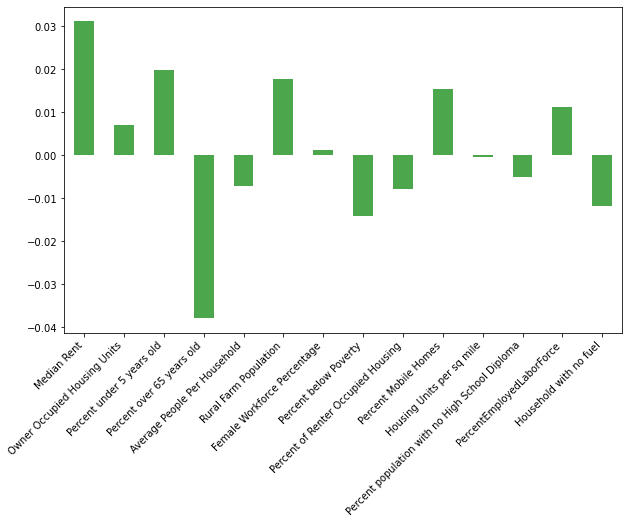

In [69]:
lin_reg = LinearRegression()
params = {'normalize': [True, False]}
grid_search = GridSearchCV(lin_reg, params, cv=5, scoring='neg_mean_squared_error')
grid_search.fit(Xar_train, yar_train)

best_params = grid_search.best_params_
best_model = grid_search.best_estimator_

importances = best_model.coef_

feature_importance_df = pd.DataFrame(importances, index=save_df.iloc[:,0:-8].columns, columns=['importance'])
ax = feature_importance_df.plot(kind='bar', legend=False, figsize=(10, 6), color='green', alpha=0.7)
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')

y_pred = best_model.predict(Xar_test)
mse = mean_squared_error(yar_test, y_pred)
rmse = np.sqrt(mse)
mae = mean_absolute_error(yar_test, y_pred)
print(f'MSE: {mse:.5f}')
print(f'RMSE: {rmse:.5f}')
print(f'MAE: {mae:.5f}')

#### For higher degree polynomial fitting:

Best Degree: 1
Minimum MSE: 0.00034
MSE: 0.00034
RMSE: 0.01845
MAE: 0.00653


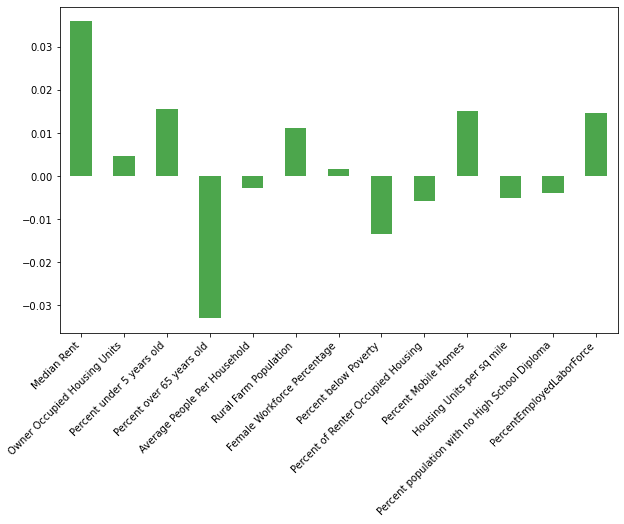

In [78]:
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline

#Users are advised to use CyberGIS compute for very high order polynomials
degree_range = range(1, 3)  
models = []
mse_scores = []
for degree in degree_range:
    model = make_pipeline(PolynomialFeatures(degree, include_bias=False), LinearRegression(normalize=True))
    model.fit(Xar_train, yar_train)
    y_pred = model.predict(Xar_test)
    mse = mean_squared_error(yar_test, y_pred)
    models.append(model)
    mse_scores.append(mse)

best_index = np.argmin(mse_scores)
best_model = models[best_index]
best_degree = degree_range[best_index]

print(f'Best Degree: {best_degree}')
print(f'Minimum MSE: {mse_scores[best_index]:.5f}')

# Original Feature Importance
num_original_features = len(save_df.iloc[:,0:-9].columns)
importances = best_model.named_steps['linearregression'].coef_
poly_features = best_model.named_steps['polynomialfeatures']
feature_names = poly_features.get_feature_names(input_features=save_df.iloc[:,0:-8].columns)
importances = importances[:num_original_features]
feature_names = feature_names[:num_original_features]
feature_importance_df = pd.DataFrame(importances, index=feature_names, columns=['importance'])
ax = feature_importance_df.plot(kind='bar', legend=False, figsize=(10, 6), color='green', alpha=0.7)
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')

rmse = np.sqrt(mse_scores[best_index])
mae = mean_absolute_error(yar_test, y_pred)
print(f'MSE: {mse_scores[best_index]:.5f}')
print(f'RMSE: {rmse:.5f}')
print(f'MAE: {mae:.5f}')

### Vulnerability

MSE: 0.00014
RMSE: 0.01182
MAE: 0.00170


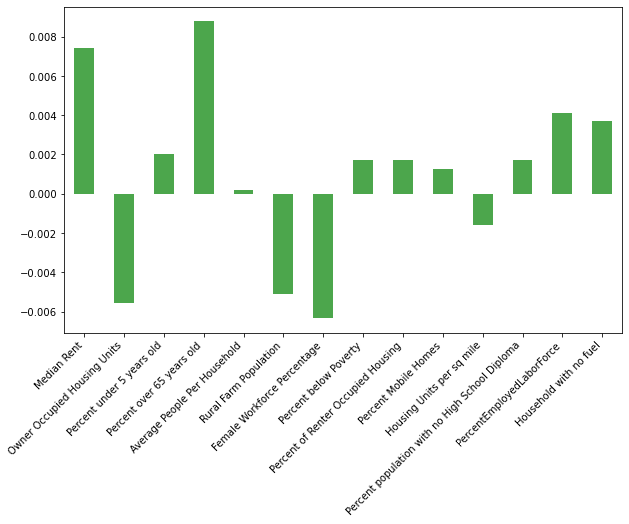

In [71]:
lin_reg = LinearRegression()

params = {'normalize': [True, False]}
grid_search = GridSearchCV(lin_reg, params, cv=5, scoring='neg_mean_squared_error')
grid_search.fit(Xvr_train, yvr_train)

best_params = grid_search.best_params_
best_model = grid_search.best_estimator_

importances = best_model.coef_

feature_importance_df = pd.DataFrame(importances, index=save_df.iloc[:,0:-8].columns, columns=['importance'])
ax = feature_importance_df.plot(kind='bar', legend=False, figsize=(10, 6), color='green', alpha=0.7)
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')

y_pred = best_model.predict(Xvr_test)
mse = mean_squared_error(yvr_test, y_pred)
rmse = np.sqrt(mse)
mae = mean_absolute_error(yvr_test, y_pred)
print(f'MSE: {mse:.5f}')
print(f'RMSE: {rmse:.5f}')
print(f'MAE: {mae:.5f}')

#### For higher degree polynomial fitting:

Best Degree: 1
Minimum MSE: 0.00016
MSE: 0.00016
RMSE: 0.01252
MAE: 0.00299


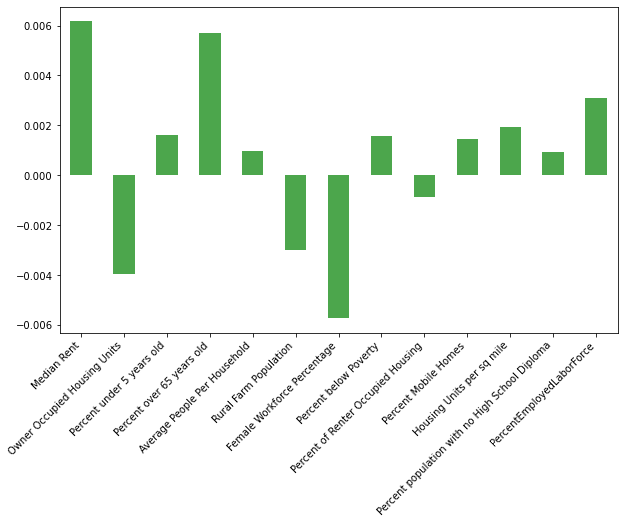

In [80]:
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline

#Users are advised to use CyberGIS compute for very high order polynomials
degree_range = range(1, 5)  
models = []
mse_scores = []
for degree in degree_range:
    model = make_pipeline(PolynomialFeatures(degree, include_bias=False), LinearRegression(normalize=True))
    model.fit(Xvr_train, yvr_train)
    y_pred = model.predict(Xvr_test)
    mse = mean_squared_error(yvr_test, y_pred)
    models.append(model)
    mse_scores.append(mse)

best_index = np.argmin(mse_scores)
best_model = models[best_index]
best_degree = degree_range[best_index]

print(f'Best Degree: {best_degree}')
print(f'Minimum MSE: {mse_scores[best_index]:.5f}')

# Original Feature Importance
num_original_features = len(save_df.iloc[:,0:-8].columns)
importances = best_model.named_steps['linearregression'].coef_
poly_features = best_model.named_steps['polynomialfeatures']
feature_names = poly_features.get_feature_names(input_features=save_df.iloc[:,0:-8].columns)
importances = importances[:num_original_features]
feature_names = feature_names[:num_original_features]
feature_importance_df = pd.DataFrame(importances, index=feature_names, columns=['importance'])
ax = feature_importance_df.plot(kind='bar', legend=False, figsize=(10, 6), color='green', alpha=0.7)
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')

rmse = np.sqrt(mse_scores[best_index])
mae = mean_absolute_error(yvr_test, y_pred)
print(f'MSE: {mse_scores[best_index]:.5f}')
print(f'RMSE: {rmse:.5f}')
print(f'MAE: {mae:.5f}')

### Resilience

MSE: 0.00047
RMSE: 0.02174
MAE: 0.00525


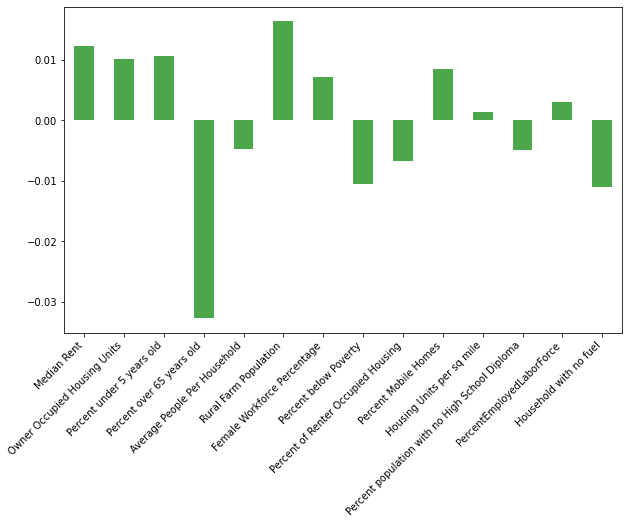

In [72]:
lin_reg = LinearRegression()

params = {'normalize': [True, False]}
grid_search = GridSearchCV(lin_reg, params, cv=5, scoring='neg_mean_squared_error')
grid_search.fit(Xrr_train, yrr_train)

best_params = grid_search.best_params_
best_model = grid_search.best_estimator_

importances = best_model.coef_

feature_importance_df = pd.DataFrame(importances, index=save_df.iloc[:,0:-8].columns, columns=['importance'])
ax = feature_importance_df.plot(kind='bar', legend=False, figsize=(10, 6), color='green', alpha=0.7)
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')

y_pred = best_model.predict(Xrr_test)
mse = mean_squared_error(yrr_test, y_pred)
rmse = np.sqrt(mse)
mae = mean_absolute_error(yrr_test, y_pred)
print(f'MSE: {mse:.5f}')
print(f'RMSE: {rmse:.5f}')
print(f'MAE: {mae:.5f}')

#### For higher degree polynomial fitting:

Best Degree: 1
Minimum MSE: 0.00085
MSE: 0.00085
RMSE: 0.02922
MAE: 0.01031


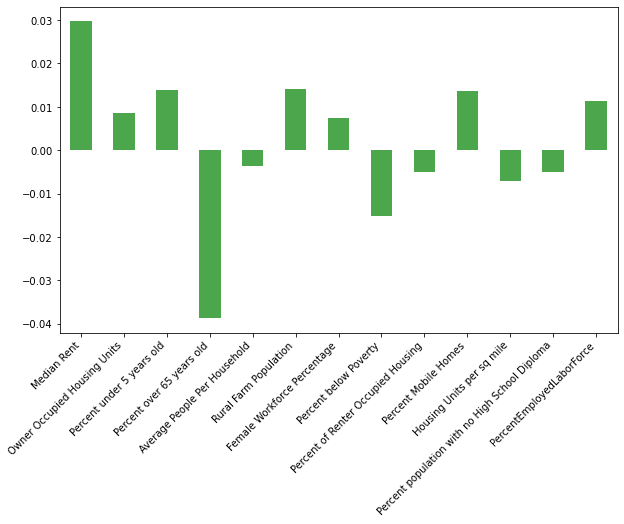

In [81]:
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline

#Users are advised to use CyberGIS compute for very high order polynomials
degree_range = range(1, 5)  
models = []
mse_scores = []
for degree in degree_range:
    model = make_pipeline(PolynomialFeatures(degree, include_bias=False), LinearRegression(normalize=True))
    model.fit(Xrr_train, yrr_train)
    y_pred = model.predict(Xrr_test)
    mse = mean_squared_error(yrr_test, y_pred)
    models.append(model)
    mse_scores.append(mse)

best_index = np.argmin(mse_scores)
best_model = models[best_index]
best_degree = degree_range[best_index]

print(f'Best Degree: {best_degree}')
print(f'Minimum MSE: {mse_scores[best_index]:.5f}')

# Original Feature Importance
num_original_features = len(save_df.iloc[:,0:-9].columns)
importances = best_model.named_steps['linearregression'].coef_
poly_features = best_model.named_steps['polynomialfeatures']
feature_names = poly_features.get_feature_names(input_features=save_df.iloc[:,0:-9].columns)
importances = importances[:num_original_features]
feature_names = feature_names[:num_original_features]
feature_importance_df = pd.DataFrame(importances, index=feature_names, columns=['importance'])
ax = feature_importance_df.plot(kind='bar', legend=False, figsize=(10, 6), color='green', alpha=0.7)
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')

rmse = np.sqrt(mse_scores[best_index])
mae = mean_absolute_error(yrr_test, y_pred)
print(f'MSE: {mse_scores[best_index]:.5f}')
print(f'RMSE: {rmse:.5f}')
print(f'MAE: {mae:.5f}')

## Ridge Regresson

Ridge regression is a linear regression algorithm used to deal with multicollinearity in data. It adds a penalty term to the sum of squared errors that forces the model to choose smaller coefficients for correlated variables. This helps to reduce the variance in the model by shrinking the regression coefficients towards zero.

Pros of Ridge Regression:
- Helps to deal with multicollinearity in the data
- Can improve the stability and generalization performance of the model
- Can prevent overfitting of the model by reducing the variance in the estimates
- Works well when the number of predictors is larger than the number of samples

Cons of Ridge Regression:
- The selection of the penalty parameter is crucial for the performance of the model
- It assumes that all predictors are relevant to the outcome, which may not always be the case
- It does not perform feature selection, meaning all variables will be retained in the model, which can lead to overfitting

### Adaptability

MSE: 0.00034
RMSE: 0.01845
MAE: 0.00691


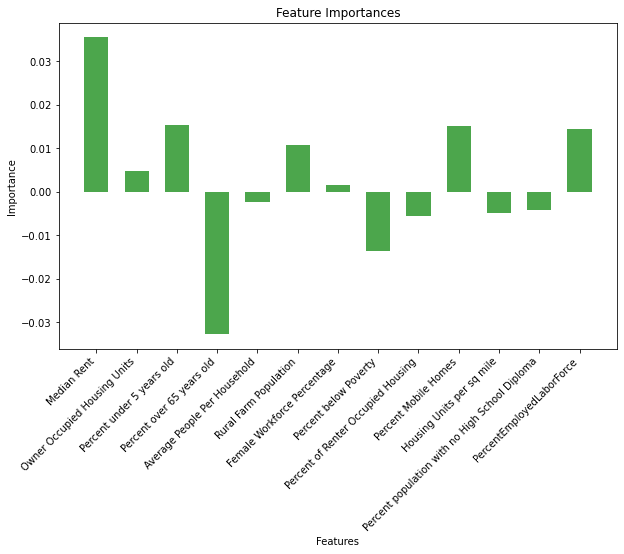

In [653]:
param_grid = {'alpha': np.logspace(-3, 3, 7)}

ridge = Ridge()
grid_search = GridSearchCV(ridge, param_grid, cv=5, scoring='neg_mean_squared_error')

grid_search.fit(Xar_train, yar_train)

best_model = grid_search.best_estimator_

importances = best_model.coef_
labels = save_df.iloc[:,0:-9].columns

fig, ax = plt.subplots(figsize=(10, 6))
ax.bar(labels, importances, color='green', alpha=0.7, width=0.6)
ax.set_xticklabels(labels, rotation=45, ha='right')
ax.set_title('Feature Importances')
ax.set_xlabel('Features')
ax.set_ylabel('Importance')

y_pred = best_model.predict(Xar_test)
mse = mean_squared_error(yar_test, y_pred)
rmse = np.sqrt(mse)
mae = mean_absolute_error(yar_test, y_pred)

print('MSE: {:.5f}'.format(mse))
print('RMSE: {:.5f}'.format(rmse))
print('MAE: {:.5f}'.format(mae))
plt.show()

### Vulnerability

MSE: 0.00016
RMSE: 0.01252
MAE: 0.00176


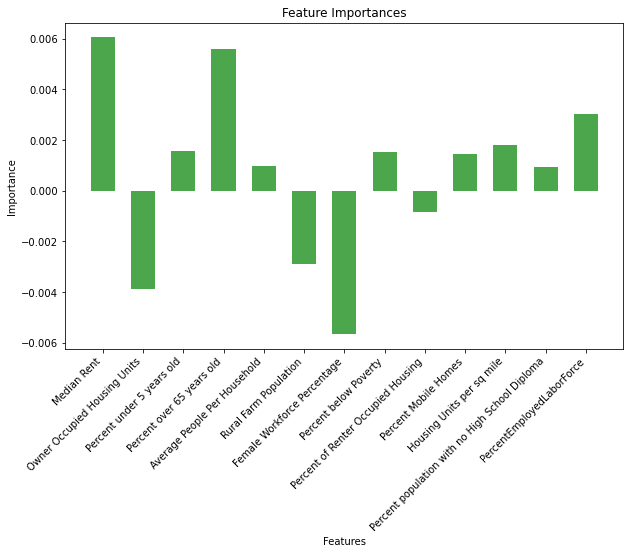

In [654]:
param_grid = {'alpha': np.logspace(-3, 3, 7)}

ridge = Ridge()
grid_search = GridSearchCV(ridge, param_grid, cv=5, scoring='neg_mean_squared_error')

grid_search.fit(Xvr_train, yvr_train2)

best_model = grid_search.best_estimator_

importances = best_model.coef_
labels = save_df.iloc[:,0:-9].columns

fig, ax = plt.subplots(figsize=(10, 6))
ax.bar(labels, importances, color='green', alpha=0.7, width=0.6)
ax.set_xticklabels(labels, rotation=45, ha='right')
ax.set_title('Feature Importances')
ax.set_xlabel('Features')
ax.set_ylabel('Importance')

y_pred = best_model.predict(Xvr_test)

mse = mean_squared_error(yvr_test2, y_pred)
rmse = np.sqrt(mse)
mae = mean_absolute_error(yvr_test2, y_pred)

print('MSE: {:.5f}'.format(mse))
print('RMSE: {:.5f}'.format(rmse))
print('MAE: {:.5f}'.format(mae))
plt.show()

### Resilience

MSE: 0.00085
RMSE: 0.02922
MAE: 0.00772


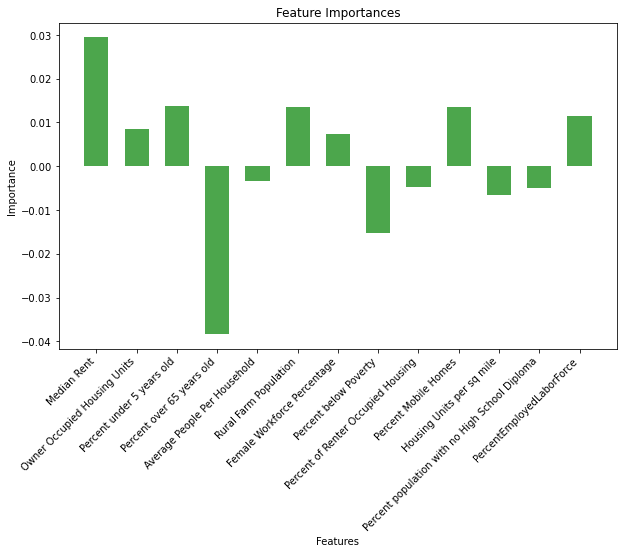

In [655]:
param_grid = {'alpha': np.logspace(-3, 3, 7)}

ridge = Ridge()
grid_search = GridSearchCV(ridge, param_grid, cv=5, scoring='neg_mean_squared_error')

grid_search.fit(Xrr_train, yrr_train)

best_model = grid_search.best_estimator_

importances = best_model.coef_
labels = save_df.iloc[:,0:-9].columns

fig, ax = plt.subplots(figsize=(10, 6))
ax.bar(labels, importances, color='green', alpha=0.7, width=0.6)
ax.set_xticklabels(labels, rotation=45, ha='right')
ax.set_title('Feature Importances')
ax.set_xlabel('Features')
ax.set_ylabel('Importance')

y_pred = best_model.predict(Xrr_test)

mse = mean_squared_error(yrr_test, y_pred)
rmse = np.sqrt(mse)
mae = mean_absolute_error(yrr_test, y_pred)

print('MSE: {:.5f}'.format(mse))
print('RMSE: {:.5f}'.format(rmse))
print('MAE: {:.5f}'.format(mae))
plt.show()

## Lasso Regresson

Lasso regression is a type of linear regression that adds a regularization term to the cost function, which helps in reducing the complexity of the model by shrinking the coefficients of the less important features to zero. 

Pros:
- It can handle high dimensional datasets with many features and avoid overfitting.
- It helps in identifying the most important features by shrinking the coefficients of the less important features to zero.
- It can be useful for feature selection.

Cons:
- Lasso regression can only be applied to linear models.
- It can be unstable when dealing with highly correlated features.
- It does not work well when the number of features is larger than the number of observations in the dataset.

### Adaptability

In [ ]:
params = {"alpha": [0.1, 1, 10]}
lasso = Lasso()
grid = GridSearchCV(lasso, params, cv=5)
grid.fit(Xar_train, yar_train)

best_estimator = grid.best_estimator_

importances = best_estimator.coef_
labels = save_df.iloc[:,0:-9].columns

fig, ax = plt.subplots(figsize=(10, 6))
ax.bar(labels, importances, color='green')
ax.set_xticklabels(labels, rotation=45, ha='right')
ax.set_title('Feature Importances')
ax.set_xlabel('Features')
ax.set_ylabel('Importance')

y_pred = best_estimator.predict(Xar_test)

mse = mean_squared_error(yar_test, y_pred)
rmse = np.sqrt(mse)
mae = mean_absolute_error(yar_test, y_pred)

print("MSE: ", mse)
print("RMSE: ", rmse)
print("MAE: ", mae)
plt.show()

### Vulnerability

In [ ]:
params = {"alpha": [0.1, 1, 10]}
lasso = Lasso()
grid = GridSearchCV(lasso, params, cv=5)
grid.fit(Xvr_train, yvr_train)

best_estimator = grid.best_estimator_

importances = best_estimator.coef_
labels = save_df.iloc[:,0:-9].columns

fig, ax = plt.subplots(figsize=(10, 6))
ax.bar(labels, importances, color='green')
ax.set_xticklabels(labels, rotation=45, ha='right')
ax.set_title('Feature Importances')
ax.set_xlabel('Features')
ax.set_ylabel('Importance')
plt.show()

y_pred = best_estimator.predict(Xvr_test)

mse = mean_squared_error(yvr_test, y_pred)
rmse = np.sqrt(mse)
mae = mean_absolute_error(yvr_test, y_pred)

print("MSE: ", mse)
print("RMSE: ", rmse)
print("MAE: ", mae)

## Support Vector Regression 

Lasso regression is a type of linear regression that adds a regularization term to the cost function, which helps in reducing the complexity of the model by shrinking the coefficients of the less important features to zero. 

Pros:
- It can handle high dimensional datasets with many features and avoid overfitting.
- It helps in identifying the most important features by shrinking the coefficients of the less important features to zero.
- It can be useful for feature selection.

Cons:
- Lasso regression can only be applied to linear models.
- It can be unstable when dealing with highly correlated features.
- It does not work well when the number of features is larger than the number of observations in the dataset.

### Adaptability

In [ ]:
svr = SVR()

param_grid = {
    'C': [0.01, 0.1, 1, 10, 100],
    'gamma': [0.01, 0.1, 1, 10, 100],
    'kernel': ['linear', 'poly', 'rbf', 'sigmoid']
}

grid_search = GridSearchCV(svr, param_grid, scoring='neg_mean_squared_error', cv=5, n_jobs=-1)
grid_search.fit(Xar_train, yar_train.values.ravel())

print("Best parameters:", grid_search.best_params_)
print("Best score:", -grid_search.best_score_)

best_model = grid_search.best_estimator_
y_pred = best_model.predict(Xar_test)

mse = mean_squared_error(yar_test, y_pred)
rmse = mean_squared_error(yar_test, y_pred, squared=False)
mae = mean_absolute_error(yar_test, y_pred)
r2 = r2_score(yar_test, y_pred)

print("MSE:", mse)
print("RMSE:", rmse)
print("MAE:", mae)
print("R^2:", r2)

results = permutation_importance(best_model, Xar_test, yar_test, n_repeats=10, random_state=random_state.value)
importances = results.importances_mean
plt.figure(figsize=(10, 6))
plt.title("Feature Importances")
plt.xlabel("Features")
plt.ylabel("Importance Score")
plt.bar(data.columns, importances, color='green')
plt.xticks(rotation=45, ha='right')
plt.show()

### Vulnerability

In [ ]:
svr = SVR()

param_grid = {
    'C': [0.01, 0.1, 1, 10, 100],
    'gamma': [0.01, 0.1, 1, 10, 100],
    'kernel': ['linear', 'poly', 'rbf', 'sigmoid']
}

grid_search = GridSearchCV(svr, param_grid, scoring='neg_mean_squared_error', cv=5, n_jobs=-1)
grid_search.fit(Xvr_train, yvr_train.values.ravel())

print("Best parameters:", grid_search.best_params_)
print("Best score:", -grid_search.best_score_)

best_model = grid_search.best_estimator_
y_pred = best_model.predict(Xvr_test)

mse = mean_squared_error(yvr_test, y_pred)
rmse = mean_squared_error(yvr_test, y_pred, squared=False)
mae = mean_absolute_error(yvr_test, y_pred)
r2 = r2_score(yvr_test, y_pred)

print("MSE:", mse)
print("RMSE:", rmse)
print("MAE:", mae)
print("R^2:", r2)

results = permutation_importance(best_model, Xvr_test, yvr_test, n_repeats=10, random_state=random_state.value)
importances = results.importances_mean
plt.figure(figsize=(10, 6))
plt.title("Feature Importances")
plt.xlabel("Features")
plt.ylabel("Importance Score")
plt.bar(data.columns, importances, color='green')
plt.xticks(rotation=45, ha='right')
plt.show()

## Random Forest Regression

Random Forest Regression builds a number of decision trees on a randomly selected subset of the training set, and then averages the predictions of each tree to produce the final prediction. The randomness in the selection of features and samples reduces the variance and overfitting.

Pros:
- Handles high dimensional datasets well
- Can handle both categorical and continuous data
- Tends to have good predictive accuracy
- Provides a measure of feature importance

Cons:
- Can be slower than other regression algorithms due to the large number of trees
- Can be difficult to interpret the relationships between the independent and dependent variables
- May overfit the training data if the number of trees is too large

### Adaptability

MSE: 0.0003192026248274502
RMSE: 0.017866242605188428
MAE: 0.00579123045526894


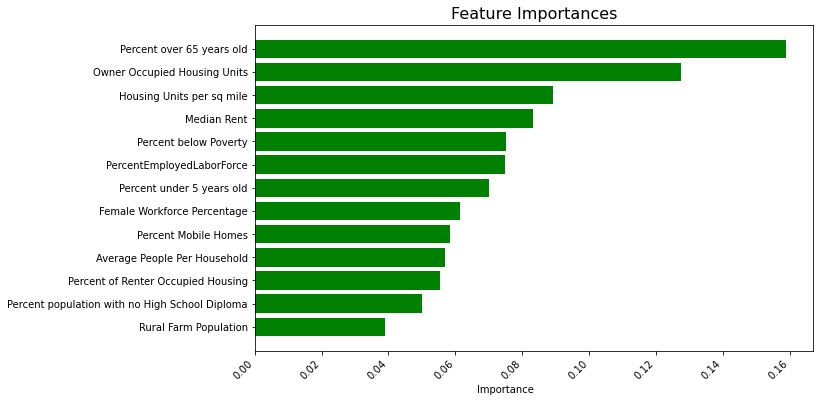

In [637]:
from sklearn.model_selection import RandomizedSearchCV
param_grid = {
    'n_estimators': [50, 100, 200],
    'max_depth': [10, 15, 20],
    'min_samples_split': [15, 20, 25],
    'min_samples_leaf': [4, 6, 8],
    'max_features': ['auto', 'sqrt']
}

rf = RandomForestRegressor(random_state=random_state.value)

rf_random = RandomizedSearchCV(estimator=rf, param_distributions=param_grid,
                               n_iter=100, cv=5, verbose=0, random_state=random_state.value, n_jobs=-1)

rf_random.fit(Xar_train, yar_train.values.ravel())
y_pred = rf_random.predict(Xar_test)

print('MSE:', mean_squared_error(yar_test, y_pred))
print('RMSE:', np.sqrt(mean_squared_error(yar_test, y_pred)))
print('MAE:', mean_absolute_error(yar_test, y_pred))

feature_importances = pd.DataFrame(rf_random.best_estimator_.feature_importances_,
                                   index = save_df.iloc[:,0:-9].columns,
                                   columns=['importance']).sort_values('importance', ascending=False)

plt.figure(figsize=(10, 6))
plt.barh(feature_importances.index, feature_importances.importance, color='green')
plt.gca().invert_yaxis()
plt.title('Feature Importances', fontsize=16)
plt.xlabel('Importance', ha='right')
plt.xticks(rotation=45, ha='right')
plt.show()

### Vulnerability

MSE: 0.0001541967652977541
RMSE: 0.012417599015017117
MAE: 0.0017931698119544827


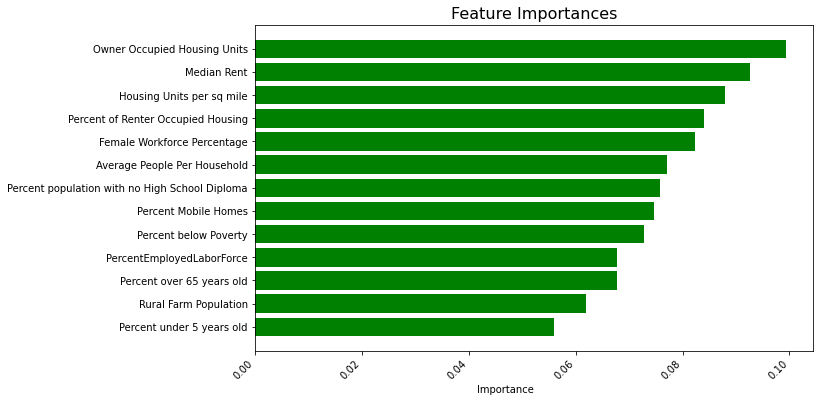

In [638]:
param_grid = {
    'n_estimators': [50, 100, 200],
    'max_depth': [5, 10, 15, 20, 25, 30],
    'min_samples_split': [2, 5, 10, 15, 20],
    'min_samples_leaf': [1, 2, 4, 6],
    'max_features': ['auto', 'sqrt']
}

rf = RandomForestRegressor(random_state=random_state.value)

rf_random = RandomizedSearchCV(estimator=rf, param_distributions=param_grid,
                               n_iter=100, cv=5, verbose=0, random_state=random_state.value, n_jobs=-1)

rf_random.fit(Xvr_train, yvr_train2.values.ravel())
y_pred = rf_random.predict(Xvr_test)

print('MSE:', mean_squared_error(yvr_test2, y_pred))
print('RMSE:', np.sqrt(mean_squared_error(yvr_test2, y_pred)))
print('MAE:', mean_absolute_error(yvr_test2, y_pred))

feature_importances = pd.DataFrame(rf_random.best_estimator_.feature_importances_,
                                   index = save_df.iloc[:,0:-9].columns,
                                   columns=['importance']).sort_values('importance', ascending=False)

plt.figure(figsize=(10, 6))
plt.barh(feature_importances.index, feature_importances.importance, color='green')
plt.gca().invert_yaxis()
plt.title('Feature Importances', fontsize=16)
plt.xlabel('Importance', ha='right')
plt.xticks(rotation=45, ha='right')
plt.show()

### Resilience

MSE: 0.0008256929996362443
RMSE: 0.02873487427562968
MAE: 0.006619147323033196


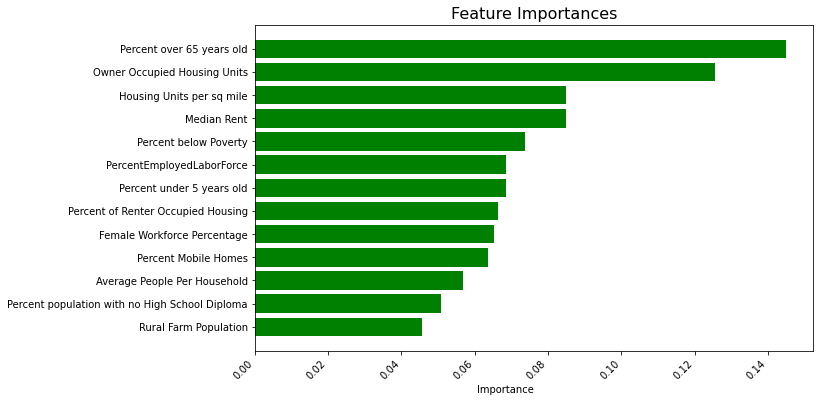

In [639]:
param_grid = {
    'n_estimators': [50, 100, 200],
    'max_depth': [5, 10, 15, 20, 25, 30],
    'min_samples_split': [2, 5, 10, 15, 20],
    'min_samples_leaf': [1, 2, 4, 6],
    'max_features': ['auto', 'sqrt']
}

rf = RandomForestRegressor(random_state=random_state.value)

rf_random = RandomizedSearchCV(estimator=rf, param_distributions=param_grid,
                               n_iter=100, cv=5, verbose=0, random_state=random_state.value, n_jobs=-1)

rf_random.fit(Xrr_train, yrr_train.values.ravel())
y_pred = rf_random.predict(Xrr_test)

print('MSE:', mean_squared_error(yrr_test, y_pred))
print('RMSE:', np.sqrt(mean_squared_error(yrr_test, y_pred)))
print('MAE:', mean_absolute_error(yrr_test, y_pred))

feature_importances = pd.DataFrame(rf_random.best_estimator_.feature_importances_,
                                   index = save_df.iloc[:,0:-9].columns,
                                   columns=['importance']).sort_values('importance', ascending=False)

plt.figure(figsize=(10, 6))
plt.barh(feature_importances.index, feature_importances.importance, color='green')
plt.gca().invert_yaxis()
plt.title('Feature Importances', fontsize=16)
plt.xlabel('Importance', ha='right')
plt.xticks(rotation=45, ha='right')
plt.show()

## XGBoost Regression

XGBoost Regression is a type of regression algorithm that uses an ensemble of decision trees to make predictions. It is an extension of the gradient boosting algorithm, and is known for its high predictive power and speed.

Pros:
- High accuracy: XGBoost Regression is known for its high accuracy and predictive power, making it a popular choice for regression tasks.
- Speed: XGBoost Regression is optimized for performance, and can handle large datasets with ease.
- Handles missing data: XGBoost Regression can handle missing data by using regularization techniques.
- Feature importance: XGBoost Regression provides a feature importance score, which can help identify the most important variables in the dataset.

Cons:
- Overfitting: XGBoost Regression can be prone to overfitting if the hyperparameters are not tuned correctly.
- Complexity: XGBoost Regression can be more complex to implement and tune than simpler regression algorithms.
- Black box: Like other ensemble methods, XGBoost Regression can be difficult to interpret due to its black box nature.

### Adaptability

Best Hyperparameters:  {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 1000}
Best Score:  0.09616455746239924
MSE:  0.0003474124613246336
RMSE:  0.018639003764274357
MAE:  0.006514389783076266


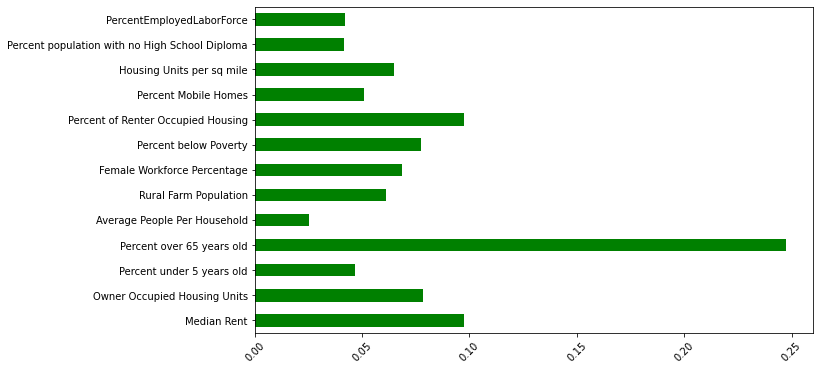

In [640]:
xgb = XGBRegressor(objective='reg:squarederror')

param_grid = {
    'n_estimators': [100, 500, 1000],
    'learning_rate': [0.01, 0.1, 1],
    'max_depth': [3, 5, 7]
}

grid_search = GridSearchCV(xgb, param_grid=param_grid, cv=5, n_jobs=-1)
grid_search.fit(Xar_train, yar_train)

print('Best Hyperparameters: ', grid_search.best_params_)
print('Best Score: ', grid_search.best_score_)

xgb_best = XGBRegressor(objective='reg:squarederror', **grid_search.best_params_)

xgb_best.fit(Xar_train, yar_train, verbose=0)

y_pred = xgb_best.predict(Xar_test)

# calculate performance metrics
mse = mean_squared_error(yar_test, y_pred)
rmse = mean_squared_error(yar_test, y_pred, squared=False)
mae = mean_absolute_error(yar_test, y_pred)

print('MSE: ', mse)
print('RMSE: ', rmse)
print('MAE: ', mae)

# plot feature importance in a column chart
fig, ax = plt.subplots(figsize=(10, 6))
importances = pd.Series(xgb_best.feature_importances_, index=save_df.iloc[:,0:-9].columns)
importances.plot(kind='barh', ax=ax, color='green')
ax.set_yticklabels(importances.index, ha='right')
plt.xticks(rotation=45)
plt.show()

### Vulnerability

Best Hyperparameters:  {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 1000}
Best Score:  -0.007423690485719092
MSE:  0.00015634979725917729
RMSE:  0.012503991253163019
MAE:  0.0018255229664791808


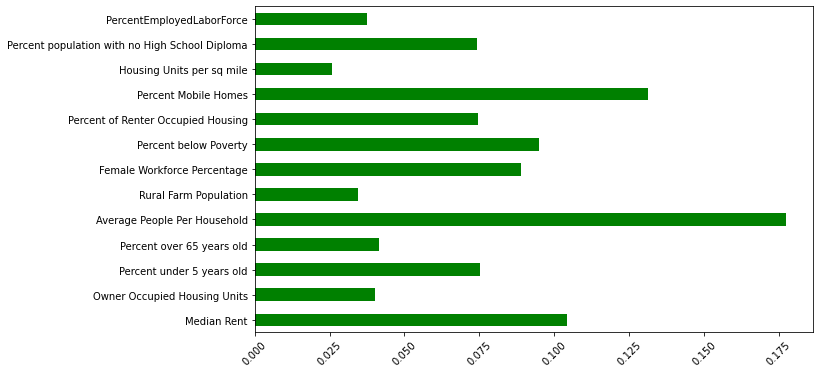

In [641]:
xgb = XGBRegressor(objective='reg:squarederror')

param_grid = {
    'n_estimators': [100, 500, 1000],
    'learning_rate': [0.01, 0.1, 1],
    'max_depth': [3, 5, 7]
}

grid_search = GridSearchCV(xgb, param_grid=param_grid, cv=5, n_jobs=-1)
grid_search.fit(Xvr_train, yvr_train)

print('Best Hyperparameters: ', grid_search.best_params_)
print('Best Score: ', grid_search.best_score_)

xgb_best = XGBRegressor(objective='reg:squarederror', **grid_search.best_params_)

xgb_best.fit(Xvr_train, yvr_train, verbose=0)

y_pred = xgb_best.predict(Xvr_test)

# calculate performance metrics
mse = mean_squared_error(yvr_test, y_pred)
rmse = mean_squared_error(yvr_test, y_pred, squared=False)
mae = mean_absolute_error(yvr_test, y_pred)

print('MSE: ', mse)
print('RMSE: ', rmse)
print('MAE: ', mae)

# plot feature importance in a column chart
fig, ax = plt.subplots(figsize=(10, 6))
importances = pd.Series(xgb_best.feature_importances_, index=save_df.iloc[:,0:-9].columns)
importances.plot(kind='barh', ax=ax, color='green')
ax.set_yticklabels(importances.index, ha='right')
plt.xticks(rotation=45)
plt.show()

### Resilience

Best Hyperparameters:  {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 500}
Best Score:  0.05809028255926445
MSE:  0.0008677034919696753
RMSE:  0.029456807226338623
MAE:  0.0074409815743899516


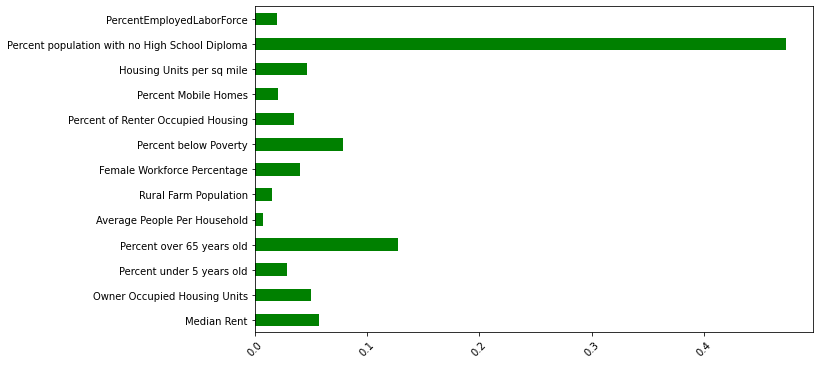

In [642]:
xgb = XGBRegressor(objective='reg:squarederror')

param_grid = {
    'n_estimators': [100, 500, 1000],
    'learning_rate': [0.01, 0.1, 1],
    'max_depth': [3, 5, 7]
}

grid_search = GridSearchCV(xgb, param_grid=param_grid, cv=5, n_jobs=-1)
grid_search.fit(Xrr_train, yrr_train)

print('Best Hyperparameters: ', grid_search.best_params_)
print('Best Score: ', grid_search.best_score_)

xgb_best = XGBRegressor(objective='reg:squarederror', **grid_search.best_params_)

xgb_best.fit(Xrr_train, yrr_train, verbose=0)

y_pred = xgb_best.predict(Xrr_test)

# calculate performance metrics
mse = mean_squared_error(yrr_test, y_pred)
rmse = mean_squared_error(yrr_test, y_pred, squared=False)
mae = mean_absolute_error(yrr_test, y_pred)

print('MSE: ', mse)
print('RMSE: ', rmse)
print('MAE: ', mae)

# plot feature importance in a column chart
fig, ax = plt.subplots(figsize=(10, 6))
importances = pd.Series(xgb_best.feature_importances_, index=save_df.iloc[:,0:-9].columns)
importances.plot(kind='barh', ax=ax, color='green')
ax.set_yticklabels(importances.index, ha='right')
plt.xticks(rotation=45)
plt.show()

## Bayesian Network

### Adaptability

In [62]:
inputcd = save_df.drop(["Y_Class", "YA_Class", "YV_Class", "YR_Value", "YV_Value", "FIPSstate", "uniqueID"], axis=1)
inputcd.to_csv("bnlearn/Input_CD.csv", index=False)

In [86]:
%load_ext rpy2.ipython

The rpy2.ipython extension is already loaded. To reload it, use:
  %reload_ext rpy2.ipython


In [ ]:
%%R
packages <- c("readxl", "nonlinearICP", "CondIndTests", "bnlearn", "ISLR", "tidyr", "dplyr", "pracma", "caret")

for (package in packages) {
  if (!require(package, character.only = TRUE)) {
    print(paste("Installing", package))
    install.packages(package, repos='http://cran.rstudio.com/')
  }
  library(package, character.only = TRUE)
}

In [64]:
score='YA_Value'

Finding best test and alpha parameters for the Bayesian Network:

In [67]:
from rpy2.robjects import pandas2ri, r
from rpy2.robjects.packages import importr
path = 'bnlearn/CD.r'
r(f'source("{path}")')
r('cd')(score)

R[write to console]: Error in file(file, "rt") : cannot open the connection

R[write to console]: In addition: 
R[write to console]: Warning message:

R[write to console]: In file(file, "rt") :
R[write to console]: 
 
R[write to console]:  cannot open file 'Input_CD.csv': No such file or directory



RRuntimeError: Error in file(file, "rt") : cannot open the connection


Finding the directed arcs:

In [ ]:
df = pd.read_csv("bnlearn/PC_Stable_Score.csv") 

min_rmse_row = df[df['RMSE'] == df['RMSE'].min()].iloc[0]

test = min_rmse_row['Test']
alpha = min_rmse_row['Alpha']

In [ ]:
pandas2ri.activate()

base = importr('base')
utils = importr('utils')

p = 1-test_split.value

path_to_r_script = 'bnlearn/PC_Stable.R'

r(f'source("{path_to_r_script}")')

results = r('pcstable')(p, test, alpha, score)

arcs_df = pandas2ri.ri2py(results[0])
coefficients_df = pandas2ri.ri2py(results[1])
parents_node = results[2]  
mae = results[3]  
mse = results[4]  
rmse = results[5]  

print(arcs_df)
print(coefficients_df)
print('Parents of YA_Value:', parents_node)
print('Mean Absolute Error:', mae)
print('Mean Squared Error:', mse)
print('Root Mean Squared Error:', rmse)

In [ ]:
from IPython.display import Image
Image(filename='bnlearn/bnplot.png') 

### Vulnerability

In [ ]:
inputcd = save_df.drop(["Y_Class", "YA_Class", "YV_Class", "YR_Value", "YA_Value", "FIPSstate", "uniqueID"], axis=1)
inputcd.to_csv("bnlearn/Input_CD.csv", index=False)

In [ ]:
score='YV_Value'

Finding best test and alpha parameters for the Bayesian Network:

In [ ]:
from rpy2.robjects import pandas2ri, r
from rpy2.robjects.packages import importr

path_to_r_script = 'bnlearn/CD.R'

r(f'source("{path_to_r_script}")')
r('cd')(score)

Finding the directed arcs:

In [ ]:
df = pd.read_csv("bnlearn/PC_Stable_Score.csv") 

min_rmse_row = df[df['RMSE'] == df['RMSE'].min()].iloc[0]

test = min_rmse_row['Test']
alpha = min_rmse_row['Alpha']

In [ ]:
pandas2ri.activate()

base = importr('base')
utils = importr('utils')

p = 1-test_split.value

path_to_r_script = 'bnlearn/PC_Stable.R'

r(f'source("{path_to_r_script}")')

results = r('pcstable')(p, test, alpha, score)

arcs_df = pandas2ri.ri2py(results[0])
coefficients_df = pandas2ri.ri2py(results[1])
parents_node = results[2]  
mae = results[3]  
mse = results[4]  
rmse = results[5]  

print(arcs_df)
print(coefficients_df)
print('Parents of YA_Value:', parents_node)
print('Mean Absolute Error:', mae)
print('Mean Squared Error:', mse)
print('Root Mean Squared Error:', rmse)

In [ ]:
from IPython.display import Image
Image(filename='bnlearn/bnplot.png') 

### Resilience

In [ ]:
inputcd = save_df.drop(["Y_Class", "YA_Class", "YV_Class", "YA_Value", "YV_Value", "FIPSstate", "uniqueID"], axis=1)
inputcd.to_csv("bnlearn/Input_CD.csv", index=False)

In [ ]:
score='YR_Value'

Finding best test and alpha parameters for the Bayesian Network:

In [ ]:
from rpy2.robjects import pandas2ri, r
from rpy2.robjects.packages import importr

path_to_r_script = 'bnlearn/CD.R'

r(f'source("{path_to_r_script}")')
r('cd')(score)

Finding the directed arcs:

In [ ]:
df = pd.read_csv("bnlearn/PC_Stable_Score.csv") 

min_rmse_row = df[df['RMSE'] == df['RMSE'].min()].iloc[0]

test = min_rmse_row['Test']
alpha = min_rmse_row['Alpha']

In [ ]:
pandas2ri.activate()

base = importr('base')
utils = importr('utils')

p = 1-test_split.value

path_to_r_script = 'bnlearn/PC_Stable.R'

r(f'source("{path_to_r_script}")')

results = r('pcstable')(p, test, alpha, score)

arcs_df = pandas2ri.ri2py(results[0])
coefficients_df = pandas2ri.ri2py(results[1])
parents_node = results[2]  
mae = results[3]  
mse = results[4]  
rmse = results[5]  

print(arcs_df)
print(coefficients_df)
print('Parents of YA_Value:', parents_node)
print('Mean Absolute Error:', mae)
print('Mean Squared Error:', mse)
print('Root Mean Squared Error:', rmse)

In [ ]:
from IPython.display import Image
Image(filename='bnlearn/bnplot.png') 

# Classifiers

## Gaussian Fit Algorithm

<ul>
    <li>Naive Bayes (NB) is a <b>supervised machine learning algorithm</b>.</li>
    <li><b>Purpose:</b> Predict the classification of a query sample by relying on labeled input data which are separated into classes.</li>
    <li><b>Assumption:</b> Features are independent of each other (Naive).</li>
    <li>No curse of dimensionality</li>
    <li>Less prone to overfitting</li>
    <li>Can handle multicollinearity</li>
    <li>Sensitive to outliers and imbalanced data</li>
</ul>

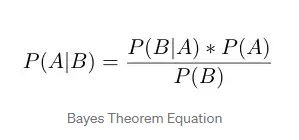

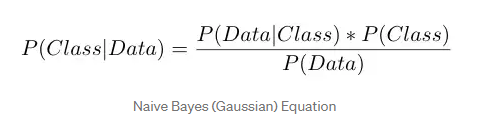

### Resilience Score

In [ ]:
param_grid = {
    'var_smoothing': np.logspace(0,-9, num=100)
}

gnb = GaussianNB()
gnb_cv = GridSearchCV(gnb, param_grid, cv=5, n_jobs=-1)
gnb_cv.fit(X_train, y_train)

print("Best Hyperparameters: ",gnb_cv.best_params_)
print("Best Model: ",gnb_cv.best_estimator_)

gnb = gnb_cv.best_estimator_
gnb.fit(X_train, y_train)

# Getting feature importances
# Please complete

y_pred = gnb.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
print("Accuracy on Test Data: {:.2f}%".format(accuracy*100))

### Vulnerability Index

In [ ]:
# Defining the parameter grid to be searched over
param_grid = {
    'var_smoothing': np.logspace(0,-9, num=100)
}

# Performing Grid Search Cross Validation
gnb = GaussianNB()
gnb_cv = GridSearchCV(gnb, param_grid, cv=5, n_jobs=-1)
gnb_cv.fit(Xvc_train, yvc_train)

# Printing the best hyperparameters
print("Best Hyperparameters: ",gnb_cv.best_params_)
print("Best Model: ",gnb_cv.best_estimator_)

# Fitting the model on the whole dataset with best hyperparameters
gnb = gnb_cv.best_estimator_
gnb.fit(Xvc_train, yvc_train)

# Getting feature importances
#Please complete

# Predicting on test data and calculating accuracy
y_pred = gnb.predict(Xvc_test)
accuracy = accuracy_score(yvc_test, y_pred)
print("Accuracy on Test Data: {:.2f}%".format(accuracy*100))

### Adaptability Index

In [ ]:
# Defining the parameter grid to be searched over
param_grid = {
    'var_smoothing': np.logspace(0,-9, num=100)
}

# Performing Grid Search Cross Validation
gnb = GaussianNB()
gnb_cv = GridSearchCV(gnb, param_grid, cv=5, n_jobs=-1)
gnb_cv.fit(Xac_train, yac_train)

# Printing the best hyperparameters
print("Best Hyperparameters: ",gnb_cv.best_params_)
print("Best Model: ",gnb_cv.best_estimator_)

# Fitting the model on the whole dataset with best hyperparameters
gnb = gnb_cv.best_estimator_
gnb.fit(Xac_train, yac_train)

# Predicting on test data and calculating accuracy
y_pred = gnb.predict(Xac_test)
accuracy = accuracy_score(yac_test, y_pred)
print("Accuracy on Test Data: {:.2f}%".format(accuracy*100))

## Linear Discriminant Analysis Algorithm

Linear Discriminant Analysis (LDA) Classifier is a linear classification algorithm that models the distribution of the independent variables in each class and uses this information to find the decision boundary that maximizes the separation between the classes. 

Pros:
- LDA is a fast and simple algorithm that works well when the number of features is small compared to the number of samples.
- LDA is less prone to overfitting than other linear classifiers.
- LDA can be used for both binary and multiclass classification.

Cons:
- LDA assumes that the distribution of the independent variables in each class is Gaussian, which may not be the case in practice.
- LDA assumes that the variance of the independent variables is the same for all classes, which may not be the case in practice.
- LDA does not perform well when the classes are not well-separated or when there is a large overlap between the classes.

### Resilience Score

In [ ]:
from sklearn.model_selection import cross_val_score

In [ ]:
lda = LinearDiscriminantAnalysis()
params = {'solver': ['svd', 'lsqr', 'eigen']}
lda_grid = GridSearchCV(lda, params)
lda_grid.fit(X_train, y_train)

y_pred = lda_grid.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
print("Accuracy on Test Data: {:.2f}%".format(accuracy*100))
print("\n")

scores = cross_val_score(lda_grid, X_test, y_pred, cv=5)
print(f"Cross-validation accuracy: {scores.mean()}")

importances = lda_grid.best_estimator_.coef_[0]
feature_names = data.columns
importances_dict = dict(zip(feature_names, importances))
importances_sorted = sorted(importances_dict.items(), key=lambda x: x[1], reverse=True)
importances_mean = [x[1] for x in importances_sorted]
feature_names_sorted = [x[0] for x in importances_sorted]

print('Feature: Score')
for i,v in enumerate(importances):
    print('%s: %.5f' % (save_df.iloc[:,0:-9].columns[i],v))

fig, ax = plt.subplots(figsize=(10, 6))
ax.bar(feature_names_sorted, importances_mean, color='green')
ax.set_title("Feature Importances")
x_ticks = list(range(len(save_df.iloc[:,2:-9].columns)))
ax.set_xticks(x_ticks)
ax.set_xticklabels(feature_names_sorted, rotation=45, ha='right')
plt.show()

### Adaptability Index

In [ ]:
lda = LinearDiscriminantAnalysis()
params = {'solver': ['svd', 'lsqr', 'eigen']}
lda_grid = GridSearchCV(lda, params)
lda_grid.fit(Xac_train, yac_train)

y_pred = lda_grid.predict(Xac_test)
accuracy = accuracy_score(yac_test, y_pred)
print("Accuracy on Test Data: {:.2f}%".format(accuracy*100))
print("\n")

importances = lda_grid.best_estimator_.coef_[0]
feature_names = data.columns
importances_dict = dict(zip(feature_names, importances))
importances_sorted = sorted(importances_dict.items(), key=lambda x: x[1], reverse=True)
importances_mean = [x[1] for x in importances_sorted]
feature_names_sorted = [x[0] for x in importances_sorted]

print('Feature: Score')
for i,v in enumerate(importances):
    print('%s: %.5f' % (save_df.iloc[:,0:-9].columns[i],v))

fig, ax = plt.subplots(figsize=(10, 6))
ax.bar(feature_names_sorted, importances_mean, color='green')
ax.set_title("Feature Importances")
x_ticks = list(range(len(save_df.iloc[:,2:-9].columns)))
ax.set_xticks(x_ticks)
ax.set_xticklabels(feature_names_sorted, rotation=45, ha='right')
plt.show()

### Vulnerability Index

In [ ]:
lda = LinearDiscriminantAnalysis()
params = {'solver': ['svd', 'lsqr', 'eigen']}
lda_grid = GridSearchCV(lda, params)
lda_grid.fit(Xvc_train, yvc_train)

y_pred = lda_grid.predict(Xvc_test)
accuracy = accuracy_score(yvc_test, y_pred)
print("Accuracy on Test Data: {:.2f}%".format(accuracy*100))
print("\n")

importances = lda_grid.best_estimator_.coef_[0]
feature_names = data.columns
importances_dict = dict(zip(feature_names, importances))
importances_sorted = sorted(importances_dict.items(), key=lambda x: x[1], reverse=True)
importances_mean = [x[1] for x in importances_sorted]
feature_names_sorted = [x[0] for x in importances_sorted]

print('Feature: Score')
for i,v in enumerate(importances):
    print('%s: %.5f' % (save_df.iloc[:,0:-9].columns[i],v))

fig, ax = plt.subplots(figsize=(10, 6))
ax.bar(feature_names_sorted, importances_mean, color='green')
ax.set_title("Feature Importances")
x_ticks = list(range(len(save_df.iloc[:,2:-9].columns)))
ax.set_xticks(x_ticks)
ax.set_xticklabels(feature_names_sorted, rotation=45, ha='right')
plt.show()

## Logistic Regression

Logistic Regression is a statistical algorithm used for binary classification tasks. It models the relationship between a dependent binary variable and a set of independent variables by estimating probabilities using a logistic function. The output of a logistic regression model is the probability of the occurrence of the binary outcome. 

Pros:
- Logistic Regression is simple and easy to implement
- It is computationally efficient and works well on large datasets
- It can handle non-linear effects and interactions between variables with appropriate feature engineering
- Provides interpretable results in terms of feature importance

Cons:
- Logistic Regression is not suitable for solving multiclass classification problems
- It assumes a linear relationship between the independent variables and the dependent variable, which may not always be true
- It may be affected by the presence of outliers and multicollinearity in the data
- It may require careful feature engineering and regularization to avoid overfitting.

### Resilience Score

In [ ]:
log_reg = LogisticRegression()
hyperparameters = {
    'penalty': ['l1', 'l2', 'elasticnet', 'none'],
    'C': np.logspace(-4, 4, 20),
    'solver': ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'],
    'max_iter': [100, 500, 1000, 5000]
}

# Using GridSearchCV to find the best hyperparameters for the model
grid_search = GridSearchCV(log_reg, hyperparameters, cv=5)
grid_search.fit(X_train, y_train)

# Print the best hyperparameters
print("Best hyperparameters: ", grid_search.best_params_)

# best hyperparameters to fit the model
log_reg = LogisticRegression(**grid_search.best_params_)
log_reg.fit(X_train, y_train)

# accuracy on test data
y_pred = log_reg.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
print("Accuracy on Test Data: {:.2f}%".format(accuracy*100))

# Get feature importances
importances = log_reg.coef_
importances_mean = np.mean(importances, axis=0)

# feature importances chart
fig, ax = plt.subplots(figsize=(10, 6))
ax.bar(data.columns, importances_mean, color='green')
ax.set_title("Feature Importances")
x_ticks = list(range(len(save_df.iloc[:,0:-9].columns)))
ax.set_xticks(x_ticks)
ax.set_xticklabels(save_df.iloc[:,0:-9].columns, rotation=45, ha='right')
plt.show()

### Vulnerability Index

In [ ]:
log_reg = LogisticRegression()
hyperparameters = {
    'penalty': ['l1', 'l2', 'elasticnet', 'none'],
    'C': np.logspace(-4, 4, 20),
    'solver': ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'],
    'max_iter': [100, 500, 1000, 5000]
}

grid_search = GridSearchCV(log_reg, hyperparameters, cv=5)
grid_search.fit(Xvc_train, yvc_train)

print("Best hyperparameters: ", grid_search.best_params_)
log_reg = LogisticRegression(**grid_search.best_params_)
log_reg.fit(Xvc_train, yvc_train)

# Print the accuracy on test data
y_pred = log_reg.predict(Xvc_test)
accuracy = accuracy_score(yvc_test, y_pred)
print("Accuracy on Test Data: {:.2f}%".format(accuracy*100))

# Get feature importances
importances = log_reg.coef_
importances_mean = np.mean(importances, axis=0)

# Print the feature importances in a column chart
fig, ax = plt.subplots(figsize=(10, 6))
ax.bar(data.columns, importances_mean, color='green')
ax.set_title("Feature Importances")
x_ticks = list(range(len(save_df.iloc[:,0:-9].columns)))
ax.set_xticks(x_ticks)
ax.set_xticklabels(save_df.iloc[:,0:-9].columns, rotation=45, ha='right')
plt.show()

### Adaptability Index

In [ ]:
log_reg = LogisticRegression()
hyperparameters = {
    'penalty': ['l1', 'l2', 'elasticnet', 'none'],
    'C': np.logspace(-4, 4, 20),
    'solver': ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'],
    'max_iter': [100, 500, 1000, 5000]
}

grid_search = GridSearchCV(log_reg, hyperparameters, cv=5)
grid_search.fit(Xac_train, yac_train)

print("Best hyperparameters: ", grid_search.best_params_)
log_reg = LogisticRegression(**grid_search.best_params_)
log_reg.fit(Xac_train, yac_train)

# Print the accuracy on test data
y_pred = log_reg.predict(Xac_test)
accuracy = accuracy_score(yac_test, y_pred)
print("Accuracy on Test Data: {:.2f}%".format(accuracy*100))

# Get feature importances
importances = log_reg.coef_
importances_mean = np.mean(importances, axis=0)

# Print the feature importances in a column chart
fig, ax = plt.subplots(figsize=(10, 6))
ax.bar(data.columns, importances_mean, color='green')
ax.set_title("Feature Importances")
x_ticks = list(range(len(save_df.iloc[:,0:-9].columns)))
ax.set_xticks(x_ticks)
ax.set_xticklabels(save_df.iloc[:,0:-9].columns, rotation=45, ha='right')
plt.show()

## Random Forest Algorithm

### Resilience Score

Random Forest Classifier is a type of ensemble learning model that combines multiple decision trees to improve the accuracy and reduce overfitting. In Random Forest Classifier, each tree is built using a random subset of features and a random subset of data samples. The final prediction is made by aggregating the predictions of all the trees.

Pros:
- Handles high dimensional data well
- Can handle missing values and outliers
- Provides feature importance ranking
- Tends to perform well on a wide range of classification problems
- Reduces overfitting compared to individual decision trees

Cons:
- Can be slow for large datasets
- Interpretation of the model may be difficult due to the complexity of the model
- May not perform as well as other models such as support vector machines on some datasets.

In [ ]:
param_grid = {
    'n_estimators': [50, 100, 200],
    'max_depth': [3, 5, 10, 20],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

# Create a Random Forest Classifier
rf = RandomForestClassifier(random_state=random_state.value)

# Use GridSearchCV to find the best hyperparameters
rf_grid = GridSearchCV(estimator=rf, param_grid=param_grid, cv=5)
rf_grid.fit(X_train, y_train)

# Print the best hyperparameters
print("Best hyperparameters: ", rf_grid.best_params_)

# Train the model with the best hyperparameters
rf_best = RandomForestClassifier(**rf_grid.best_params_, random_state=random_state.value)
rf_best.fit(X_train, y_train)

# Get the feature importances
importances = rf_best.feature_importances_
feature_names = save_df.iloc[:,0:-9].columns
importances_df = pd.DataFrame({'Feature': feature_names, 'Importance': importances})
importances_df.sort_values(by='Importance', ascending=False, inplace=True)

# Plot the feature importances
plt.figure(figsize=(10, 6))
plt.title("Feature Importances")
plt.xlabel("Features")
plt.ylabel("Importance Score")
plt.bar(importances_df['Feature'], importances_df['Importance'], color='green')
plt.xticks(rotation=45, ha='right')
plt.show()

# Predict the test data and print the accuracy
y_pred = rf_best.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
print("Accuracy on Test Data: {:.2f}%".format(accuracy*100))

### Vulnerability Index

In [ ]:
param_grid = {
    'n_estimators': [50, 100, 200],
    'max_depth': [3, 5, 10, 20],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

# Create a Random Forest Classifier
rf = RandomForestClassifier(random_state=random_state.value)

# Use GridSearchCV to find the best hyperparameters
rf_grid = GridSearchCV(estimator=rf, param_grid=param_grid, cv=5)
rf_grid.fit(Xvc_train, yvc_train)

# Print the best hyperparameters
print("Best hyperparameters: ", rf_grid.best_params_)

# Train the model with the best hyperparameters
rf_best = RandomForestClassifier(**rf_grid.best_params_, random_state=random_state.value)
rf_best.fit(Xvc_train, yvc_train)

# Get the feature importances
importances = rf_best.feature_importances_
feature_names = save_df.iloc[:,0:-9].columns
importances_df = pd.DataFrame({'Feature': feature_names, 'Importance': importances})
importances_df.sort_values(by='Importance', ascending=False, inplace=True)

# Plot the feature importances
plt.figure(figsize=(10, 6))
plt.title("Feature Importances")
plt.xlabel("Features")
plt.ylabel("Importance Score")
plt.bar(importances_df['Feature'], importances_df['Importance'], color='green')
plt.xticks(rotation=45, ha='right')
plt.show()

# Predict the test data and print the accuracy
y_pred = rf_best.predict(Xvc_test)
accuracy = accuracy_score(yvc_test, y_pred)
print("Accuracy on Test Data: {:.2f}%".format(accuracy*100))

### Adaptability Index

In [ ]:
param_grid = {
    'n_estimators': [50, 100, 200],
    'max_depth': [3, 5, 10, 20],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

# Create a Random Forest Classifier
rf = RandomForestClassifier(random_state=random_state.value)

# Use GridSearchCV to find the best hyperparameters
rf_grid = GridSearchCV(estimator=rf, param_grid=param_grid, cv=5)
rf_grid.fit(Xac_train, yac_train)

# Print the best hyperparameters
print("Best hyperparameters: ", rf_grid.best_params_)

# Train the model with the best hyperparameters
rf_best = RandomForestClassifier(**rf_grid.best_params_, random_state=random_state.value)
rf_best.fit(Xac_train, yac_train)

# Get the feature importances
importances = rf_best.feature_importances_
feature_names = save_df.iloc[:,0:-9].columns
importances_df = pd.DataFrame({'Feature': feature_names, 'Importance': importances})
importances_df.sort_values(by='Importance', ascending=False, inplace=True)

plt.figure(figsize=(10, 6))
plt.title("Feature Importances")
plt.xlabel("Features")
plt.ylabel("Importance Score")
plt.bar(importances_df['Feature'], importances_df['Importance'], color='green')
plt.xticks(rotation=45, ha='right')
plt.show()

# Predict the test data and print the accuracy
y_pred = rf_best.predict(Xac_test)
accuracy = accuracy_score(yac_test, y_pred)
print("Accuracy on Test Data: {:.2f}%".format(accuracy*100))

## XGBoost Algorithm

XGBoost Classifier is a type of gradient boosting algorithm that is used for classification tasks. It is based on decision trees and combines the strengths of boosting and bagging techniques to improve model accuracy and reduce overfitting. The key features of XGBoost Classifier are:

Pros:
- Highly accurate: XGBoost Classifier is considered one of the most accurate classification algorithms.
- Fast and scalable: It can handle large datasets and can be parallelized on multiple CPU cores.
- Regularization: It has built-in regularization techniques to prevent overfitting.
- Feature importance: It provides a measure of feature importance, which can be used for feature selection.

Cons:
- Complexity: XGBoost Classifier is a complex algorithm and requires careful tuning of hyperparameters.
- Black-box model: The inner workings of XGBoost Classifier are not easily interpretable, making it difficult to understand how the model is making predictions.
- Imbalanced datasets: It may not perform well on imbalanced datasets without additional techniques such as oversampling or undersampling.

### Resilience Score

In [ ]:
from xgboost import XGBClassifier

param_grid = {
    'max_depth': [3, 4, 5, 6, 7],
    'learning_rate': [0.01, 0.05, 0.1, 0.3],
    'n_estimators': [50, 100, 200, 500]
}

# Creating the XGBoost Classifier object
xgb = XGBClassifier()
y_train = y_train-1
y_test = y_test-1
# Performing a grid search to find the best hyperparameters for the model
grid_search = GridSearchCV(xgb, param_grid, scoring='accuracy', n_jobs=-1, cv=5)
grid_result = grid_search.fit(X_train, y_train)

# Getting the best hyperparameters and creating the final model
best_params = grid_result.best_params_
final_model = XGBClassifier(**best_params)

# Fitting the final model on the training data
final_model.fit(X_train, y_train, verbose=0)

# Getting predictions on the test data
y_pred = final_model.predict(X_test)

# Calculating the accuracy score of the model on the test data
accuracy = accuracy_score(y_test, y_pred)
print("Accuracy on Test Data: {:.2f}%".format(accuracy*100))

# Getting the feature importances and plotting them in a column chart
feature_importances = pd.Series(final_model.feature_importances_, index=save_df.iloc[:,0:-9].columns)
plt.figure(figsize=(10, 6))
feature_importances.plot(kind='barh', color='green')
plt.title("Feature Importances")
plt.xlabel("Features")
plt.ylabel("Importance Score")
plt.xticks(rotation=45, ha='right')
plt.show()

### Vulnerability Index

In [ ]:
param_grid = {
    'max_depth': [3, 4, 5, 6, 7],
    'learning_rate': [0.01, 0.05, 0.1, 0.3],
    'n_estimators': [50, 100, 200, 500]
}

# Creating the XGBoost Classifier object
xgb = XGBClassifier()
yvc_xgb= np.add(yvc_train, 1)
# Performing a grid search to find the best hyperparameters for the model
grid_search = GridSearchCV(xgb, param_grid, scoring='accuracy', n_jobs=-1, cv=5)
grid_result = grid_search.fit(Xvc_train, yvc_xgb, verbose=0)

# Getting the best hyperparameters and creating the final model
best_params = grid_result.best_params_
final_model = XGBClassifier(**best_params)

# Fitting the final model on the training data
final_model.fit(Xvc_train, yvc_xgb)

# Getting predictions on the test data
y_pred = final_model.predict(Xvc_test)
test_xgb = np.add(yac_test,1)
# Calculating the accuracy score of the model on the test data
accuracy = accuracy_score(test_xgb, y_pred)
print("Accuracy on Test Data: {:.2f}%".format(accuracy*100))

# Getting the feature importances and plotting them in a column chart
feature_importances = pd.Series(final_model.feature_importances_, index=save_df.iloc[:,0:-9].columns)
plt.figure(figsize=(10, 6))
feature_importances.plot(kind='barh', color='green')
plt.title("Feature Importances")
plt.xlabel("Features")
plt.ylabel("Importance Score")
plt.xticks(rotation=45, ha='right')
plt.show()

### Adaptability Index

In [ ]:
from xgboost import XGBClassifier

param_grid = {
    'max_depth': [3, 4, 5, 6, 7],
    'learning_rate': [0.01, 0.05, 0.1, 0.3],
    'n_estimators': [50, 100, 200, 500]
}

# Creating the XGBoost Classifier object
xgb = XGBClassifier()
yac_xgb= np.add(yac_train, 1)
# Performing a grid search to find the best hyperparameters for the model
grid_search = GridSearchCV(xgb, param_grid, scoring='accuracy', n_jobs=-1, cv=5)
grid_result = grid_search.fit(Xac_train, yac_xgb, verbose=0)

# Getting the best hyperparameters and creating the final model
best_params = grid_result.best_params_
final_model = XGBClassifier(**best_params)

# Fitting the final model on the training data
final_model.fit(Xac_train, yac_xgb)

# Getting predictions on the test data
y_pred = final_model.predict(Xac_test)
test_xgb = np.add(yac_test,1)
# Calculating the accuracy score of the model on the test data
accuracy = accuracy_score(test_xgb, y_pred)
print("Accuracy on Test Data: {:.2f}%".format(accuracy*100))

# Getting the feature importances and plotting them in a column chart
feature_importances = pd.Series(final_model.feature_importances_, index=save_df.iloc[:,0:-9].columns)
plt.figure(figsize=(10, 6))
feature_importances.plot(kind='barh', color='green')
plt.title("Feature Importances")
plt.xlabel("Features")
plt.ylabel("Importance Score")
plt.xticks(rotation=45, ha='right')
plt.show()

---